## Introduction to Embeddings

Embeddings are a way to represent data (like words, sentences, or images) as vectors of numbers. These vectors capture semantic meaning, allowing machines to understand relationships and similarities.

**Why embeddings matter:**
- They convert unstructured data into structured numerical form
- Similar items have similar vectors
- Enable mathematical operations on semantic content
- Foundation for modern AI applications



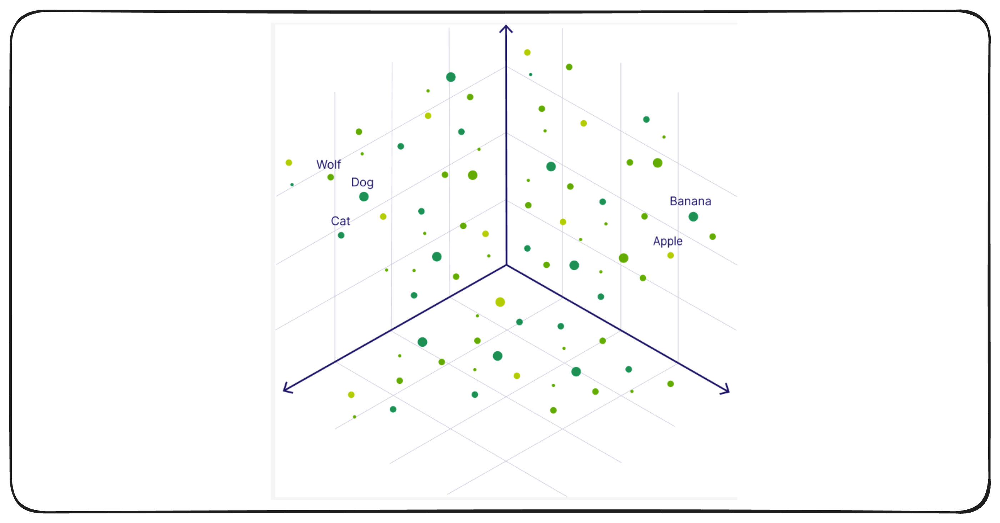![Embedding Visualization Placeholder](https://via.placeholder.com/800x300.png?text=Word+Embeddings+Visualization)



---

## Setup: Install Required Libraries

In [ ]:
# Install required packages
!pip install -q sentence-transformers matplotlib numpy scikit-learn plotly

In [ ]:
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.decomposition import PCA
import plotly.graph_objects as go
import warnings
warnings.filterwarnings('ignore')

print("✓ All libraries imported successfully")

✓ All libraries imported successfully


---

## What Are Embeddings?

Embeddings transform text into fixed-size numerical vectors. Each dimension captures a different aspect of meaning.

**Key properties:**
- Fixed dimensionality (e.g., 384, 768, or 1536 dimensions)
- Semantic relationships preserved as geometric relationships
- Similar meanings → similar vectors

---

## Loading a Pre-trained Embedding Model

In [ ]:
# Load a lightweight sentence transformer model
# 'all-MiniLM-L6-v2' produces 384-dimensional embeddings
model = SentenceTransformer('all-MiniLM-L6-v2')

print(f"Model loaded: {model}")
print(f"Embedding dimension: 384")

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

Model loaded: SentenceTransformer(
  (0): Transformer({'max_seq_length': 256, 'do_lower_case': False, 'architecture': 'BertModel'})
  (1): Pooling({'word_embedding_dimension': 384, 'pooling_mode_cls_token': False, 'pooling_mode_mean_tokens': True, 'pooling_mode_max_tokens': False, 'pooling_mode_mean_sqrt_len_tokens': False, 'pooling_mode_weightedmean_tokens': False, 'pooling_mode_lasttoken': False, 'include_prompt': True})
  (2): Normalize()
)
Embedding dimension: 384


---

## Creating Your First Embeddings

In [ ]:
# Sample sentences
sentences = [
    "The cat sits on the mat",
    "A dog plays in the park",
    "The kitten rests on the rug",
    "Python is a programming language",
    "Machine learning is fascinating"
]

# Generate embeddings
embeddings = model.encode(sentences)

print(f"Shape of embeddings: {embeddings.shape}")
print(f"Number of sentences: {len(sentences)}")
print(f"Embedding dimension: {embeddings.shape[1]}")

Shape of embeddings: (5, 384)
Number of sentences: 5
Embedding dimension: 384


In [ ]:
# Inspect the first embedding (truncated for readability)
print("\nFirst 10 values of the first embedding:")
print(embeddings[0][:10])
print("\n...")
print(f"\nTotal values in each embedding: {len(embeddings[0])}")


First 10 values of the first embedding:
[ 0.13489065 -0.03206335 -0.02033524  0.03590098 -0.02833307  0.04150218
  0.03315877  0.03660568  0.0086166   0.03763957]

...

Total values in each embedding: 384


---

## Understanding Similarity

Cosine similarity measures how similar two embeddings are. Values range from -1 (opposite) to 1 (identical).

**Interpretation:**
- 0.9 - 1.0: Very similar
- 0.7 - 0.9: Similar
- 0.4 - 0.7: Somewhat related
- 0.0 - 0.4: Unrelated

In [ ]:
# Calculate cosine similarity between all pairs
similarity_matrix = cosine_similarity(embeddings)

print("Similarity Matrix:")
print("=" * 80)

# Display with sentence labels
for i, sent_i in enumerate(sentences):
    print(f"\n'{sent_i}'")
    for j, sent_j in enumerate(sentences):
        if i != j:  # Skip self-comparison
            score = similarity_matrix[i][j]
            print(f"  vs '{sent_j}': {score:.3f}")

Similarity Matrix:

'The cat sits on the mat'
  vs 'A dog plays in the park': 0.152
  vs 'The kitten rests on the rug': 0.664
  vs 'Python is a programming language': 0.032
  vs 'Machine learning is fascinating': -0.065

'A dog plays in the park'
  vs 'The cat sits on the mat': 0.152
  vs 'The kitten rests on the rug': 0.102
  vs 'Python is a programming language': 0.112
  vs 'Machine learning is fascinating': 0.045

'The kitten rests on the rug'
  vs 'The cat sits on the mat': 0.664
  vs 'A dog plays in the park': 0.102
  vs 'Python is a programming language': 0.034
  vs 'Machine learning is fascinating': -0.092

'Python is a programming language'
  vs 'The cat sits on the mat': 0.032
  vs 'A dog plays in the park': 0.112
  vs 'The kitten rests on the rug': 0.034
  vs 'Machine learning is fascinating': 0.207

'Machine learning is fascinating'
  vs 'The cat sits on the mat': -0.065
  vs 'A dog plays in the park': 0.045
  vs 'The kitten rests on the rug': -0.092
  vs 'Python is a progra

---

## Visualizing Similarities with a Heatmap

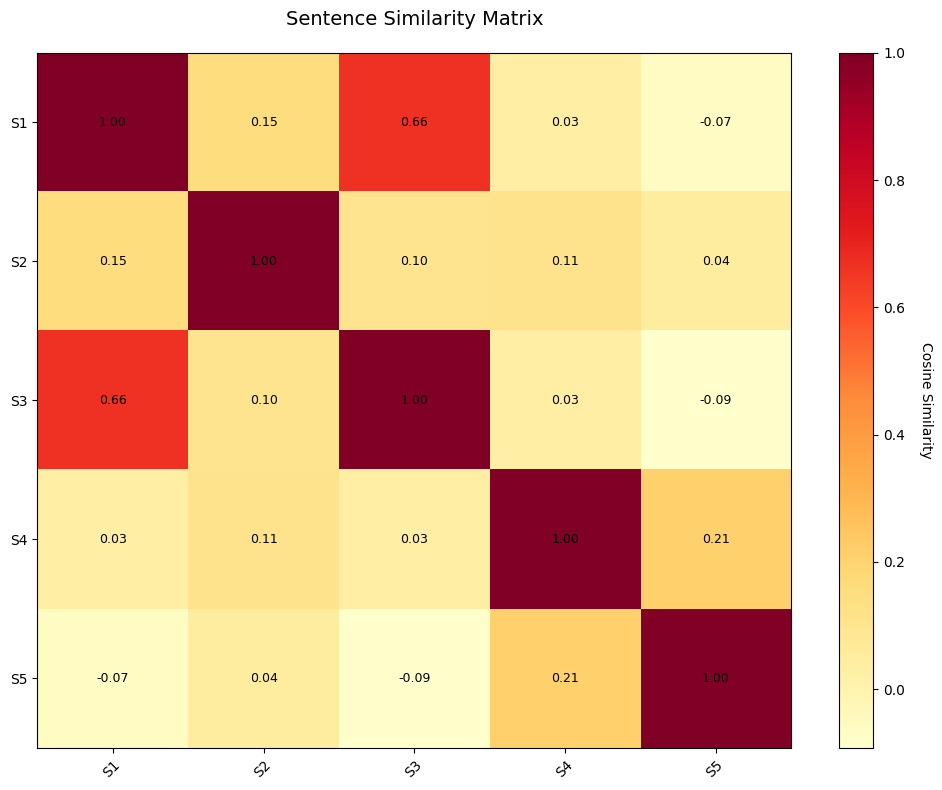


Sentence Key:
S1: The cat sits on the mat
S2: A dog plays in the park
S3: The kitten rests on the rug
S4: Python is a programming language
S5: Machine learning is fascinating


In [ ]:
# Create a heatmap of similarities
fig, ax = plt.subplots(figsize=(10, 8))

im = ax.imshow(similarity_matrix, cmap='YlOrRd', aspect='auto')

# Set ticks and labels
ax.set_xticks(np.arange(len(sentences)))
ax.set_yticks(np.arange(len(sentences)))
ax.set_xticklabels([f"S{i+1}" for i in range(len(sentences))])
ax.set_yticklabels([f"S{i+1}" for i in range(len(sentences))])

# Rotate the tick labels for better readability
plt.setp(ax.get_xticklabels(), rotation=45, ha="right", rotation_mode="anchor")

# Add colorbar
cbar = plt.colorbar(im, ax=ax)
cbar.set_label('Cosine Similarity', rotation=270, labelpad=20)

# Add text annotations
for i in range(len(sentences)):
    for j in range(len(sentences)):
        text = ax.text(j, i, f'{similarity_matrix[i, j]:.2f}',
                      ha="center", va="center", color="black", fontsize=9)

ax.set_title("Sentence Similarity Matrix", fontsize=14, pad=20)
plt.tight_layout()
plt.show()

# Print legend
print("\nSentence Key:")
for i, sent in enumerate(sentences):
    print(f"S{i+1}: {sent}")

---

## Finding Most Similar Sentences

In [ ]:
# Function to find most similar sentences to a query
def find_similar(query, sentences, embeddings, top_k=3):
    # Encode the query
    query_embedding = model.encode([query])

    # Calculate similarities
    similarities = cosine_similarity(query_embedding, embeddings)[0]

    # Get top-k indices
    top_indices = similarities.argsort()[-top_k:][::-1]

    print(f"Query: '{query}'\n")
    print("Most similar sentences:")
    for rank, idx in enumerate(top_indices, 1):
        print(f"  {rank}. '{sentences[idx]}' (similarity: {similarities[idx]:.3f})")

    return top_indices, similarities[top_indices]

# Test with a new query
query = "A small cat on a carpet"
find_similar(query, sentences, embeddings)

Query: 'A small cat on a carpet'

Most similar sentences:
  1. 'The cat sits on the mat' (similarity: 0.603)
  2. 'The kitten rests on the rug' (similarity: 0.599)
  3. 'A dog plays in the park' (similarity: 0.139)


(array([0, 2, 1]), array([0.6027569 , 0.5987097 , 0.13919993], dtype=float32))

---

## Visualizing Embeddings in 2D Space

High-dimensional embeddings can be reduced to 2D for visualization using PCA (Principal Component Analysis).

In [ ]:
# Reduce embeddings to 2D using PCA
pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(embeddings)

print(f"Original dimension: {embeddings.shape[1]}")
print(f"Reduced dimension: {embeddings_2d.shape[1]}")
print(f"Variance explained: {sum(pca.explained_variance_ratio_):.2%}")

Original dimension: 384
Reduced dimension: 2
Variance explained: 68.30%


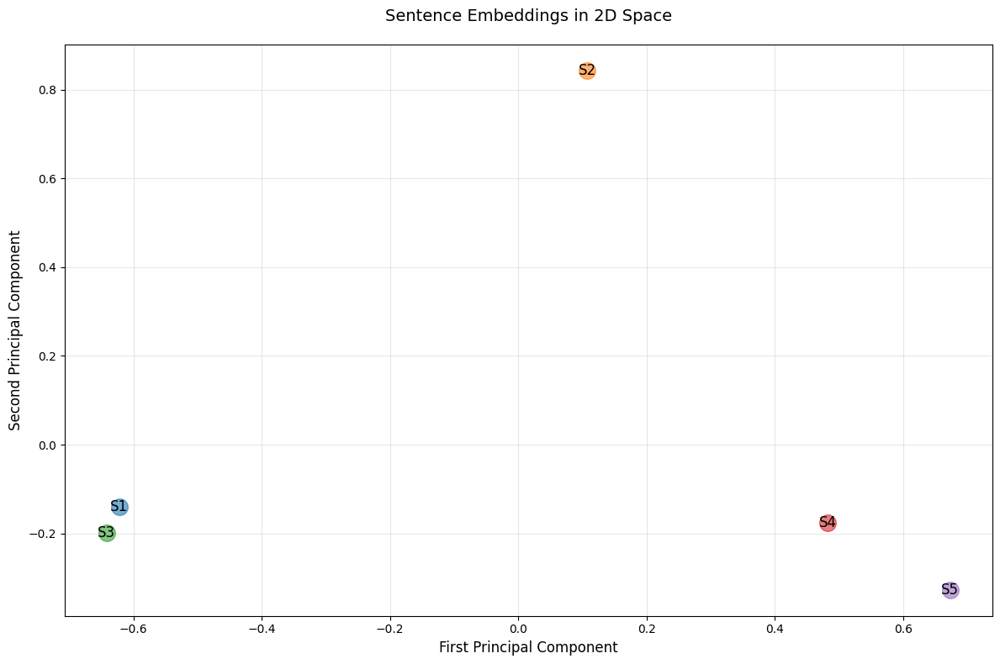


Sentence Key:
S1: The cat sits on the mat
S2: A dog plays in the park
S3: The kitten rests on the rug
S4: Python is a programming language
S5: Machine learning is fascinating


In [ ]:
# Create 2D scatter plot
plt.figure(figsize=(12, 8))

# Plot points
for i, (x, y) in enumerate(embeddings_2d):
    plt.scatter(x, y, s=200, alpha=0.6)
    plt.annotate(f"S{i+1}", (x, y), fontsize=12, ha='center', va='center')

plt.xlabel('First Principal Component', fontsize=12)
plt.ylabel('Second Principal Component', fontsize=12)
plt.title('Sentence Embeddings in 2D Space', fontsize=14, pad=20)
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

# Print legend
print("\nSentence Key:")
for i, sent in enumerate(sentences):
    print(f"S{i+1}: {sent}")

---

## Interactive 3D Visualization

In [ ]:
# Reduce to 3D for richer visualization
pca_3d = PCA(n_components=3)
embeddings_3d = pca_3d.fit_transform(embeddings)

# Create interactive 3D plot
fig = go.Figure(data=[go.Scatter3d(
    x=embeddings_3d[:, 0],
    y=embeddings_3d[:, 1],
    z=embeddings_3d[:, 2],
    mode='markers+text',
    marker=dict(size=10, color=np.arange(len(sentences)), colorscale='Viridis', opacity=0.8),
    text=[f"S{i+1}" for i in range(len(sentences))],
    textposition="top center",
    hovertext=sentences,
    hoverinfo='text'
)])

fig.update_layout(
    title="3D Embedding Space",
    scene=dict(
        xaxis_title='PC1',
        yaxis_title='PC2',
        zaxis_title='PC3'
    ),
    height=600
)

fig.show()

print("Hover over points to see full sentences")

Hover over points to see full sentences


---

## Practical Example: Semantic Search

In [ ]:
# Expanded dataset
documents = [
    "Machine learning models learn patterns from data",
    "Deep neural networks have multiple layers",
    "Natural language processing analyzes text",
    "Computer vision processes images and videos",
    "The cat jumped over the fence",
    "Dogs are loyal and friendly pets",
    "Python is great for data science",
    "JavaScript runs in web browsers",
    "The weather is sunny today",
    "Climate change affects global temperatures"
]

# Generate embeddings for all documents
doc_embeddings = model.encode(documents)

print(f"Indexed {len(documents)} documents")
print(f"Each document represented as {doc_embeddings.shape[1]}-dimensional vector")

Indexed 10 documents
Each document represented as 384-dimensional vector


In [ ]:
# Semantic search function
def semantic_search(query, documents, doc_embeddings, top_k=5):
    # Encode query
    query_embedding = model.encode([query])

    # Calculate similarities
    similarities = cosine_similarity(query_embedding, doc_embeddings)[0]

    # Get top results
    top_indices = similarities.argsort()[-top_k:][::-1]

    print(f"Query: '{query}'\n")
    print(f"Top {top_k} Results:")
    print("=" * 80)
    for rank, idx in enumerate(top_indices, 1):
        print(f"{rank}. {documents[idx]}")
        print(f"   Similarity: {similarities[idx]:.3f}\n")

# Test semantic search
semantic_search("How do AI systems learn?", documents, doc_embeddings, top_k=3)

Query: 'How do AI systems learn?'

Top 3 Results:
1. Machine learning models learn patterns from data
   Similarity: 0.525

2. Deep neural networks have multiple layers
   Similarity: 0.295

3. Computer vision processes images and videos
   Similarity: 0.272



In [ ]:
# Try another query
semantic_search("pets and animals", documents, doc_embeddings, top_k=3)

Query: 'pets and animals'

Top 3 Results:
1. Dogs are loyal and friendly pets
   Similarity: 0.557

2. The cat jumped over the fence
   Similarity: 0.228

3. JavaScript runs in web browsers
   Similarity: 0.133



---

## Key Takeaways

**What you learned:**
- Embeddings convert text into numerical vectors
- Similar meanings produce similar vectors
- Cosine similarity measures semantic closeness
- Pre-trained models like Sentence Transformers make this easy
- Visualizations help understand embedding spaces

**Next steps:**
- Explore different embedding models
- Work with larger datasets
- Learn about vector databases for efficient search
- Understand chunking strategies for long documents



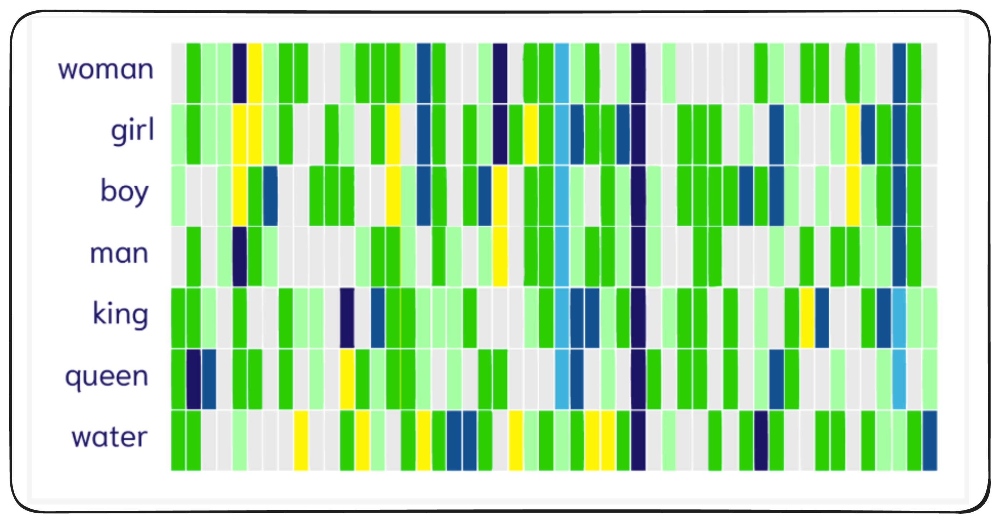

### [Reference](https://weaviate.io/blog/vector-embeddings-explained)

# Word Embeddings Visualization Explained

## What This Shows
This is a **word embedding visualization** where each word is represented as a numerical vector. Each row is a word, each column is a dimension in the embedding space, and colors represent the values in those dimensions.

## Color Meaning
- **Green shades**: Positive values
- **Yellow**: Strong positive activation
- **Blue/Navy**: Negative values
- **White/Gray**: Near-zero values

## Key Insights

### 1. Similar Words Have Similar Patterns
- `woman` and `girl` show nearly identical color patterns
- `boy` and `man` share similar profiles
- `king` and `queen` have comparable patterns

### 2. Mathematical Relationships
The famous vector arithmetic property:
```
king - man + woman ≈ queen
```

Gender relationships are encoded in the embedding space - the difference between `king` and `queen` mirrors the difference between `man` and `woman`.

### 3. Semantic Distance
`water` has a completely different pattern from human-related terms, showing that unrelated words occupy different regions of the embedding space.

## How It Works

Embeddings are learned from large text datasets. Words appearing in similar contexts get similar vector representations:
- Trained using Word2Vec, GloVe, or transformer models
- Each word becomes a vector of 50-300+ dimensions
- Similarity measured by vector distance (cosine similarity)

## Why It Matters

**Applications:**
- Semantic search and similarity
- Machine translation
- Recommendation systems
- Sentiment analysis

**Key Principle:** Language has geometric structure - semantic relationships translate to spatial relationships in vector space. The patterns you see are how machines learn to understand language structure.

## Distance Metrics in Embedding Space

Embeddings turn text into vectors, but the choice of **distance metric** determines which vectors are considered *“close”* or *“similar.”* Different metrics measure similarity in fundamentally different ways—some focus on **direction**, others on **magnitude**, and some on **absolute position**.

The metric you choose directly impacts which documents your retrieval system finds. A query for *“machine learning tutorials”* might return different results depending on whether you measure **angle (cosine similarity)** versus **geometric distance (Euclidean distance)**. Understanding these differences helps you make informed choices for your **RAG pipeline**.

This section explores the **four most common distance metrics**, explains when each works best, and demonstrates their behavior with concrete examples.


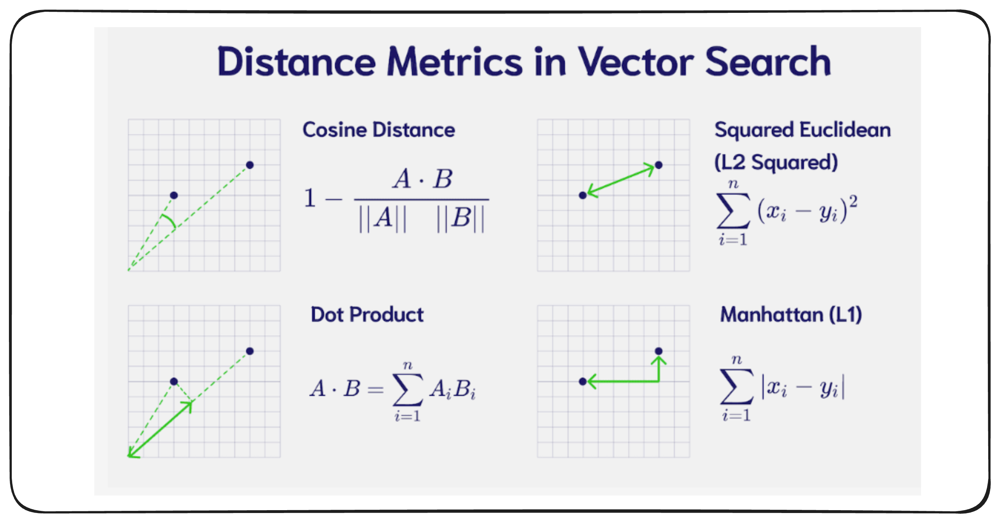

### [Reference](https://weaviate.io/blog/distance-metrics-in-vector-search)

## Cosine Similarity

### Intuition
Cosine similarity measures the **angle between two vectors**, not their length. Two vectors pointing in the same direction have high similarity (close to **1**), even if one is much longer than the other. This makes it ideal when **magnitude doesn’t matter**—only the **relative proportions of dimensions**.

In text retrieval, if one document mentions *“fruit”* 30 times and another mentions it 10 times, they might still be about the same topic. Cosine similarity captures this **directional alignment** while ignoring absolute frequency differences.

### When it works well
Most sentence transformer models are trained to work with cosine similarity. If your embeddings come from models like **`sentence-transformers`**, cosine is typically the right choice. It’s also common in NLP tasks where **document length varies significantly**.

### One key pitfall
Cosine similarity assumes your vectors are **normalized** (unit length). If they aren’t, you’re effectively using a variant that includes magnitude effects. Always verify whether your embedding model outputs normalized vectors.


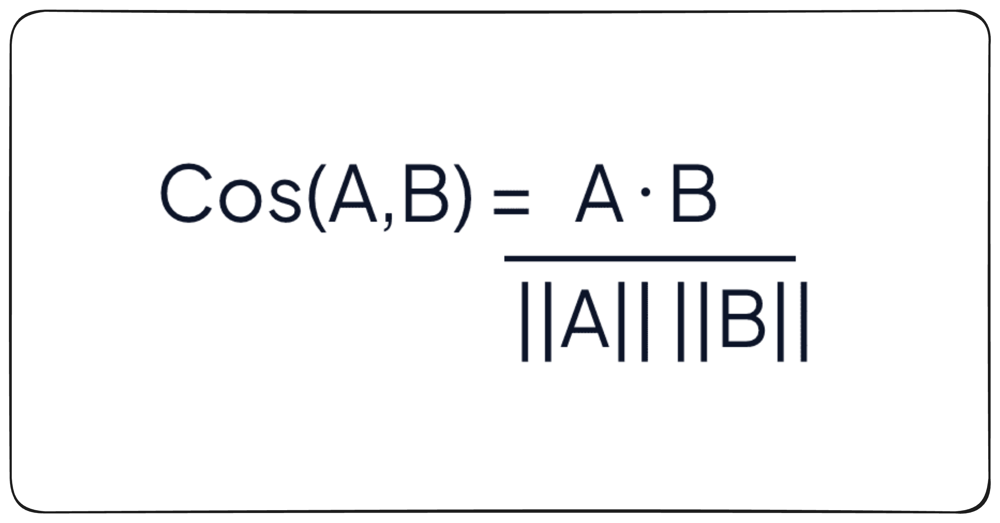

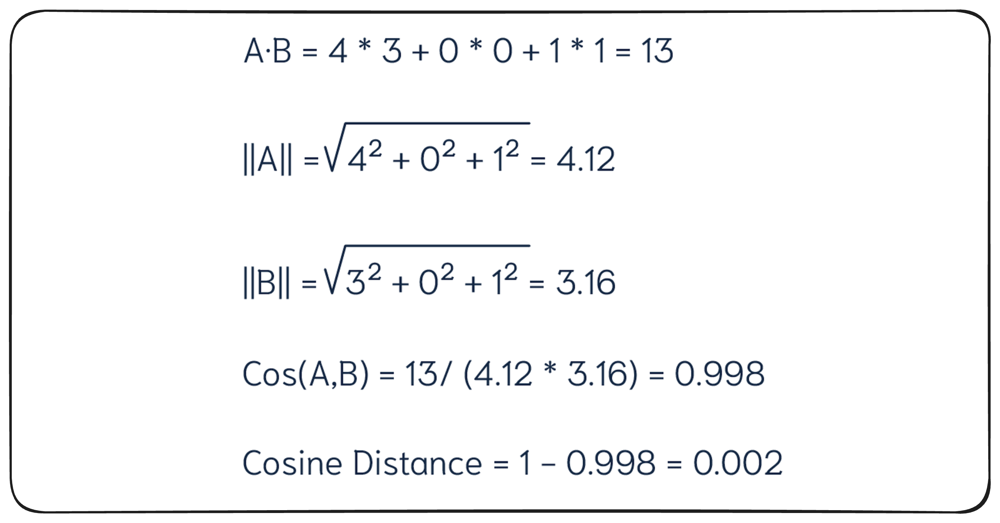

## Dot Product

### Intuition
The dot product multiplies corresponding dimensions and sums them up. Unlike cosine similarity, it captures both **direction** and **magnitude**. If two vectors point in the same direction, the dot product is large and positive. If they point in opposite directions, it’s negative.

Think of it as measuring **alignment with intensity**. A longer vector *“votes”* more strongly, so magnitude matters. This can be useful when vector length carries semantic meaning (e.g., confidence scores).

### When it works well
Use dot product when **magnitude is meaningful**—for example, if longer embeddings represent more important or more confident representations. Some neural network architectures (like certain **Siamese networks**) are explicitly trained with dot product similarity.

### One key pitfall
Dot product is **not bounded**—values can range from negative infinity to positive infinity depending on vector lengths. This makes raw scores harder to interpret. Also, if vectors aren’t normalized, dot product and cosine similarity behave very differently.


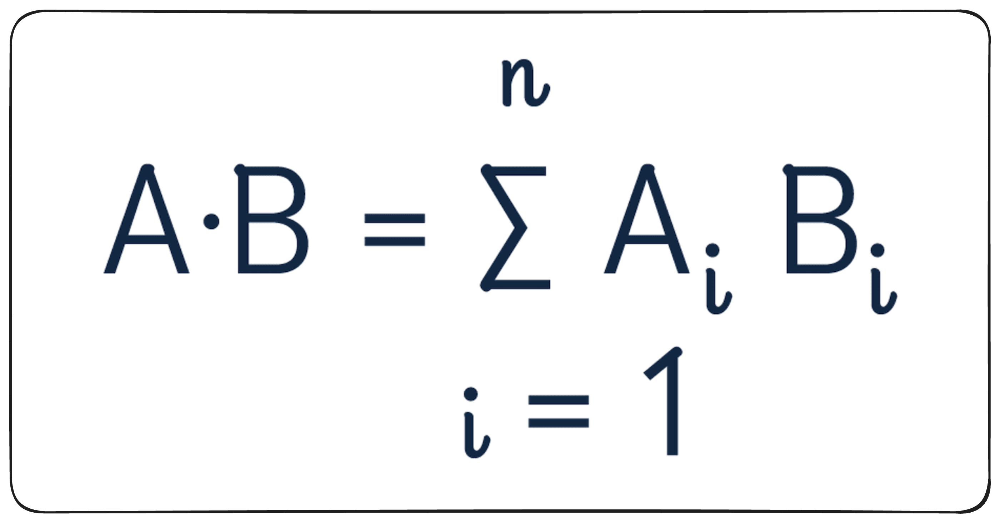

**Example vectors**

- **Strawberry** → `[4, 0, 1]`
- **Blueberry** → `[3, 0, 1]`


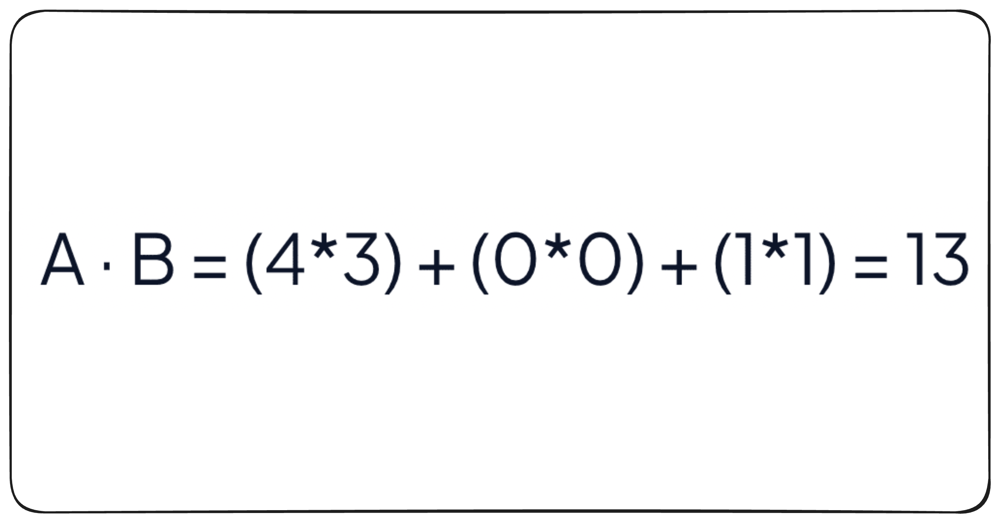

## Euclidean Distance (L2)

### Intuition
Euclidean distance (also called **L2 distance**) is the straight-line distance between two points in space. It’s the *“ruler”* distance you’d measure on a map. Smaller values mean the vectors are closer together; zero means they’re identical.

This metric treats all dimensions equally and penalizes large differences in any dimension. It’s sensitive to both **direction** and **magnitude**, making it more rigid than cosine similarity.

### When it works well
Euclidean distance works well when all dimensions have **similar scales** and when **absolute position matters**. It’s common in image embeddings and some contrastive learning setups where models are trained to minimize L2 distance between similar items.

### One key pitfall
As dimensionality increases, Euclidean distances tend to become less meaningful—all points start looking roughly equidistant (the *curse of dimensionality*). Also, if your data has wildly different scales across dimensions, L2 distance can be dominated by the largest-scale features.


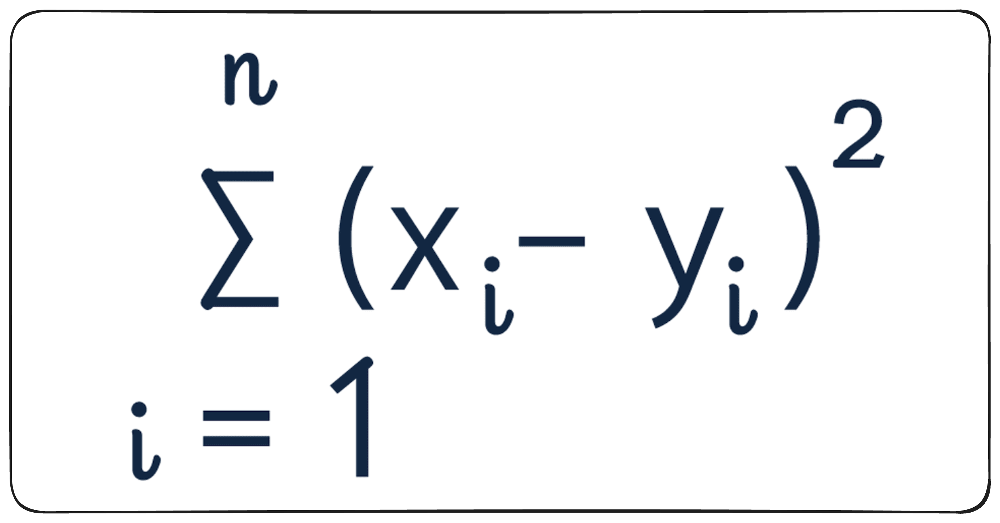

**Example vectors**

- **Strawberry** → `[4, 0, 1]`
- **Blueberry** → `[3, 0, 1]`


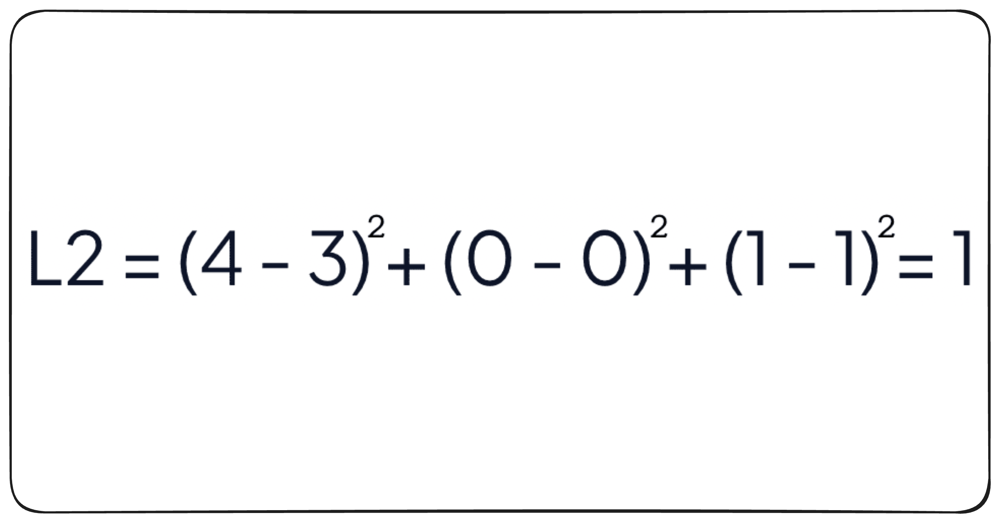

## Manhattan Distance (L1)

### Intuition
Manhattan distance (also called **L1** or **“taxicab”** distance) sums the **absolute differences** across each dimension. Imagine navigating a city grid—you can’t cut diagonally through buildings, so you measure distance by blocks walked horizontally and vertically.

Compared to Euclidean distance, Manhattan distance is faster to compute (no squaring or square roots) and less sensitive to outliers in individual dimensions. It treats each dimension’s contribution independently.

### When it works well
Manhattan distance is a practical choice for **high-dimensional spaces** where speed matters. It’s also useful when you want to avoid the *“averaging”* effect of Euclidean distance—each dimension contributes directly to the total distance.

### One key pitfall
Manhattan distance doesn’t capture **diagonal relationships** well. Two vectors that differ slightly across many dimensions may have a large Manhattan distance even if they’re conceptually similar. It’s less commonly used in modern embedding models compared to cosine similarity or Euclidean distance.


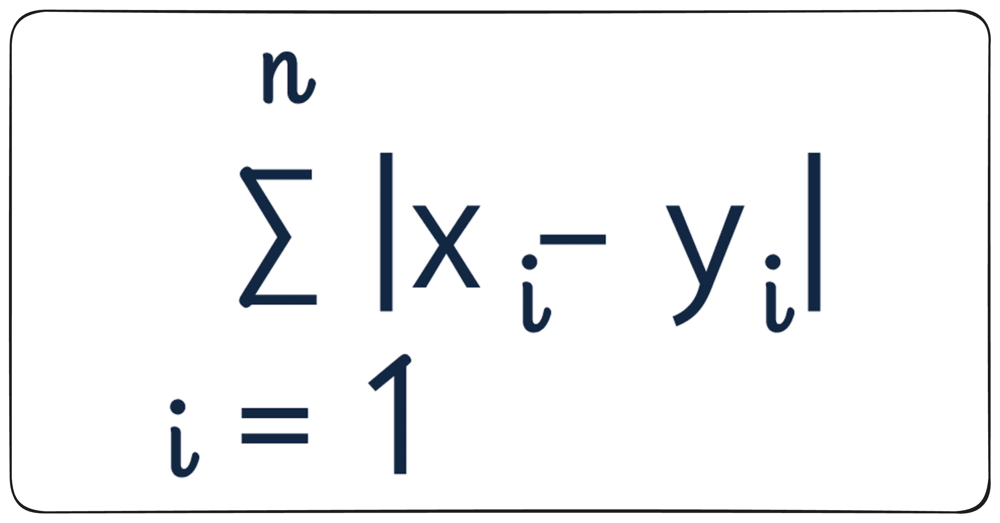

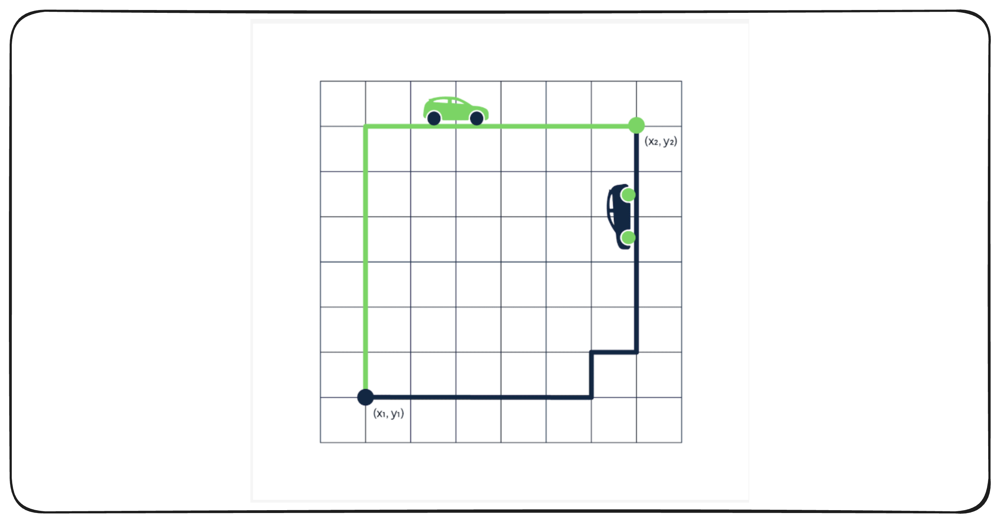

## Normalization and Its Impact

Vector **magnitude** refers to its length—how far the point is from the origin. Vector **direction** is where it points in space. Some distance metrics care about both; others care only about direction.

**Cosine similarity** is direction-focused. If you normalize all vectors to unit length (magnitude = 1), cosine similarity and dot product become **identical**. This is why many embedding models normalize their outputs by default—it simplifies similarity calculations and makes scores more interpretable.

**Unnormalized vectors** carry magnitude information. A longer vector might represent higher confidence, more frequent terms, or stronger activation. Whether magnitude is useful depends on your model and task.

### Key insight
If your embedding model normalizes vectors (check the documentation), cosine similarity and dot product will give the **same ranking**. If vectors aren’t normalized, dot product will favor longer vectors—which may or may not be what you want.


In [ ]:
import numpy as np
from sklearn.metrics.pairwise import cosine_similarity, euclidean_distances, manhattan_distances

# Define small example vectors (unnormalized)
vec_a = np.array([[4, 0, 1]])  # "Strawberry"
vec_b = np.array([[3, 0, 1]])  # "Blueberry"
vec_c = np.array([[8, 2, 9]])  # "Broccoli"

print("Original vectors:")
print(f"Strawberry: {vec_a[0]}")
print(f"Blueberry:  {vec_b[0]}")
print(f"Broccoli:   {vec_c[0]}")

Original vectors:
Strawberry: [4 0 1]
Blueberry:  [3 0 1]
Broccoli:   [8 2 9]


In [ ]:
# Cosine Similarity (direction-focused)
cos_sim_ab = cosine_similarity(vec_a, vec_b)[0][0]
cos_sim_ac = cosine_similarity(vec_a, vec_c)[0][0]

print("\nCosine Similarity (higher = more similar):")
print(f"Strawberry ↔ Blueberry: {cos_sim_ab:.4f}")
print(f"Strawberry ↔ Broccoli:  {cos_sim_ac:.4f}")


Cosine Similarity (higher = more similar):
Strawberry ↔ Blueberry: 0.9971
Strawberry ↔ Broccoli:  0.8146


In [ ]:
# Dot Product (direction + magnitude)
dot_ab = np.dot(vec_a[0], vec_b[0])
dot_ac = np.dot(vec_a[0], vec_c[0])

print("\nDot Product (higher = more similar):")
print(f"Strawberry ↔ Blueberry: {dot_ab}")
print(f"Strawberry ↔ Broccoli:  {dot_ac}")


Dot Product (higher = more similar):
Strawberry ↔ Blueberry: 13
Strawberry ↔ Broccoli:  41


In [ ]:
# Euclidean Distance (straight-line distance)
euc_ab = euclidean_distances(vec_a, vec_b)[0][0]
euc_ac = euclidean_distances(vec_a, vec_c)[0][0]

print("\nEuclidean Distance (lower = more similar):")
print(f"Strawberry ↔ Blueberry: {euc_ab:.4f}")
print(f"Strawberry ↔ Broccoli:  {euc_ac:.4f}")


Euclidean Distance (lower = more similar):
Strawberry ↔ Blueberry: 1.0000
Strawberry ↔ Broccoli:  9.1652


In [ ]:
# Manhattan Distance (city-block distance)
man_ab = manhattan_distances(vec_a, vec_b)[0][0]
man_ac = manhattan_distances(vec_a, vec_c)[0][0]

print("\nManhattan Distance (lower = more similar):")
print(f"Strawberry ↔ Blueberry: {man_ab:.4f}")
print(f"Strawberry ↔ Broccoli:  {man_ac:.4f}")


Manhattan Distance (lower = more similar):
Strawberry ↔ Blueberry: 1.0000
Strawberry ↔ Broccoli:  14.0000


In [ ]:
# Show how different metrics rank the same pairs
import pandas as pd

results = pd.DataFrame({
    'Metric': ['Cosine Sim', 'Dot Product', 'Euclidean', 'Manhattan'],
    'Strawberry ↔ Blueberry': [
        f"{cos_sim_ab:.4f} ↑",
        f"{dot_ab} ↑",
        f"{euc_ab:.4f} ↓",
        f"{man_ab:.4f} ↓"
    ],
    'Strawberry ↔ Broccoli': [
        f"{cos_sim_ac:.4f} ↑",
        f"{dot_ac} ↑",
        f"{euc_ac:.4f} ↓",
        f"{man_ac:.4f} ↓"
    ]
})

print("\nComparison Summary (↑ = higher is better, ↓ = lower is better):")
print(results.to_string(index=False))


Comparison Summary (↑ = higher is better, ↓ = lower is better):
     Metric Strawberry ↔ Blueberry Strawberry ↔ Broccoli
 Cosine Sim               0.9971 ↑              0.8146 ↑
Dot Product                   13 ↑                  41 ↑
  Euclidean               1.0000 ↓              9.1652 ↓
  Manhattan               1.0000 ↓             14.0000 ↓


#### Effect of Normalization

In [ ]:
# Normalize vectors to unit length
vec_a_norm = vec_a / np.linalg.norm(vec_a)
vec_b_norm = vec_b / np.linalg.norm(vec_b)

print("\nNormalized vectors (unit length):")
print(f"Strawberry: {vec_a_norm[0]}, length: {np.linalg.norm(vec_a_norm):.4f}")
print(f"Blueberry:  {vec_b_norm[0]}, length: {np.linalg.norm(vec_b_norm):.4f}")


Normalized vectors (unit length):
Strawberry: [0.9701425  0.         0.24253563], length: 1.0000
Blueberry:  [0.9486833  0.         0.31622777], length: 1.0000


In [ ]:
# Compare cosine and dot product on normalized vectors
cos_norm = cosine_similarity(vec_a_norm, vec_b_norm)[0][0]
dot_norm = np.dot(vec_a_norm[0], vec_b_norm[0])

print("\nAfter normalization:")
print(f"Cosine Similarity: {cos_norm:.6f}")
print(f"Dot Product:       {dot_norm:.6f}")
print(f"Difference:        {abs(cos_norm - dot_norm):.10f}")
print("\n→ Cosine and dot product are identical for normalized vectors!")


After normalization:
Cosine Similarity: 0.997054
Dot Product:       0.997054
Difference:        0.0000000000

→ Cosine and dot product are identical for normalized vectors!


## Key Takeaways

- **Cosine** focuses on direction; ideal for text embeddings from transformer models  
- **Dot product** includes magnitude; use when vector length carries meaning  
- **Euclidean** measures straight-line distance; sensitive to all dimensions equally  
- **Manhattan** is faster and treats dimensions independently  
- **Normalization** makes cosine similarity and dot product equivalent  


---

<a id="0-embeddings-overview"></a>
# Ways to Generate Embeddings

Before diving into Bi-Encoders and Cross-Encoders, let's explore the different ways to generate text embeddings.

### What are Embeddings?

Embeddings are dense vector representations of text that capture semantic meaning. Similar texts produce similar vectors, enabling:
- Semantic search
- Document similarity
- Clustering and classification

### Why Different Providers?

| Consideration | Local Models | API-Based Models |
|--------------|--------------|------------------|
| **Cost** | Free (compute only) | Pay per token |
| **Privacy** | Data stays local | Data sent to provider |
| **Customization** | Fine-tunable | Fixed |
| **Setup** | Requires dependencies | Simple API call |

Let's see both approaches in action.

### 0.1 Hugging Face Sentence Transformers (Local)

**Sentence Transformers** is an open-source library for generating embeddings locally.

**Key characteristics:**
- ✅ Runs locally — no API keys needed
- ✅ Fine-tunable for your domain
- ✅ Many pre-trained models available
- ✅ Used in bi-encoders (covered later in this notebook)

**Popular models:**
- `all-MiniLM-L6-v2` — Fast, 384 dimensions
- `all-mpnet-base-v2` — Higher quality, 768 dimensions
- `multi-qa-mpnet-base-dot-v1` — Optimized for Q&A

In [ ]:
# Hugging Face Sentence Transformers - Local Embeddings
from sentence_transformers import SentenceTransformer

# Load a pre-trained model
model_name = "sentence-transformers/all-MiniLM-L6-v2"
st_model = SentenceTransformer(model_name)

# Example texts
texts = [
    "Human rights are fundamental freedoms.",
    "Every person deserves equal treatment.",
    "The weather is sunny today."
]

# Generate embeddings
embeddings = st_model.encode(texts)

print("📦 Sentence Transformers Embeddings")
print(f"   Model: {model_name}")
print(f"   Input texts: {len(texts)}")
print(f"   Embedding shape: {embeddings.shape}")
print(f"   Single embedding dimension: {embeddings[0].shape[0]}")
print(f"\n   First embedding (first 10 values): {embeddings[0][:10]}")

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

📦 Sentence Transformers Embeddings
   Model: sentence-transformers/all-MiniLM-L6-v2
   Input texts: 3
   Embedding shape: (3, 384)
   Single embedding dimension: 384

   First embedding (first 10 values): [-0.0160352   0.06187871 -0.05692378 -0.00190308  0.02727527  0.1372043
  0.01140948 -0.06001262  0.03514559  0.04294144]


### 0.2 OpenAI Embeddings API (Hosted)

**OpenAI's Embeddings API** provides high-quality embeddings via a simple API call.

**Key characteristics:**
- ✅ State-of-the-art quality
- ✅ No local compute required
- ✅ Simple integration
- ❌ Requires API key and costs per token
- ❌ Not fine-tunable

**Current models:**
- `text-embedding-3-small` — 1536 dimensions, cost-effective
- `text-embedding-3-large` — 3072 dimensions, highest quality

In [ ]:
# OpenAI Embeddings API - Hosted Embeddings
import getpass
from openai import OpenAI

# Securely get API key
print("🔑 Enter your OpenAI API key (press Enter to skip):")
openai_key = getpass.getpass("OpenAI API Key: ")

if openai_key:
    openai_client = OpenAI(api_key=openai_key)
    print("✅ OpenAI client initialized")
else:
    openai_client = None
    print("⚠️ Skipping OpenAI embeddings (no API key)")

🔑 Enter your OpenAI API key (press Enter to skip):
OpenAI API Key: ··········
✅ OpenAI client initialized


In [ ]:
# Generate embeddings with OpenAI
if openai_client:
    # Same example texts
    texts_openai = [
        "Human rights are fundamental freedoms.",
        "Every person deserves equal treatment.",
        "The weather is sunny today."
    ]

    # Call the API
    response = openai_client.embeddings.create(
        model="text-embedding-3-small",
        input=texts_openai
    )

    # Extract embeddings
    openai_embeddings = [item.embedding for item in response.data]

    print("📦 OpenAI Embeddings")
    print(f"   Model: text-embedding-3-small")
    print(f"   Input texts: {len(texts_openai)}")
    print(f"   Single embedding dimension: {len(openai_embeddings[0])}")
    print(f"\n   First embedding (first 10 values): {openai_embeddings[0][:10]}")
else:
    print("⏭️ Skipped - OpenAI client not configured")

📦 OpenAI Embeddings
   Model: text-embedding-3-small
   Input texts: 3
   Single embedding dimension: 1536

   First embedding (first 10 values): [0.02118605002760887, 0.058695774525403976, 0.05192318558692932, 0.10019959509372711, 0.006474118214100599, -0.03631583973765373, -0.012926529161632061, 0.0491446889936924, 0.022445056587457657, -0.06681419909000397]


### 0.3 Other Embedding Providers

Several other providers offer embedding APIs with different trade-offs:

| Provider | Notable Models | Strength |
|----------|---------------|----------|
| **Cohere** | `embed-english-v3.0` | Multilingual, search-optimized |
| **Voyage AI** | `voyage-large-2` | Long context, code embeddings |
| **Google** | `text-embedding-004` | Vertex AI integration |
| **Mistral** | `mistral-embed` | European data residency |

The concepts are the same — text in, vector out. Choose based on your requirements for cost, privacy, and quality.

### 0.4 Embedding Approaches: Comparison Summary

| Provider | Hosted vs Local | Fine-tunable | Typical Use Case | Used Later in This Notebook? |
|----------|----------------|--------------|------------------|-----------------------------|
| **Sentence Transformers** | Local | ✅ Yes | Custom domains, research, bi-encoders | ✅ **Yes** — Core of tutorial |
| **OpenAI** | Hosted | ❌ No | Production RAG, general-purpose | ✅ Yes — RAG generation |
| **Cohere** | Hosted | ❌ No | Multilingual search | ❌ No |
| **Voyage** | Hosted | ❌ No | Code search, long documents | ❌ No |

---



---

<a id="1-introduction"></a>
## 1. Introduction: Bi-Encoder vs Cross-Encoder

In modern retrieval systems, especially RAG (Retrieval-Augmented Generation), we need efficient ways to find relevant documents for a given query. Two dominant architectures have emerged:

### 🔷 Bi-Encoder (Dual Encoder)

**Architecture:**
- Encodes **query** and **document** independently using the same or separate encoders
- Produces fixed-size embedding vectors for each
- Similarity is computed via dot product or cosine similarity

**Strengths:**
- ✅ **Fast at inference** — documents can be pre-encoded and indexed
- ✅ **Scalable** — works with Approximate Nearest Neighbor (ANN) search (FAISS, Pinecone, etc.)
- ✅ **Suitable for first-stage retrieval** over millions of documents

**Weaknesses:**
- ❌ No direct query-document interaction during encoding
- ❌ May miss nuanced semantic relationships

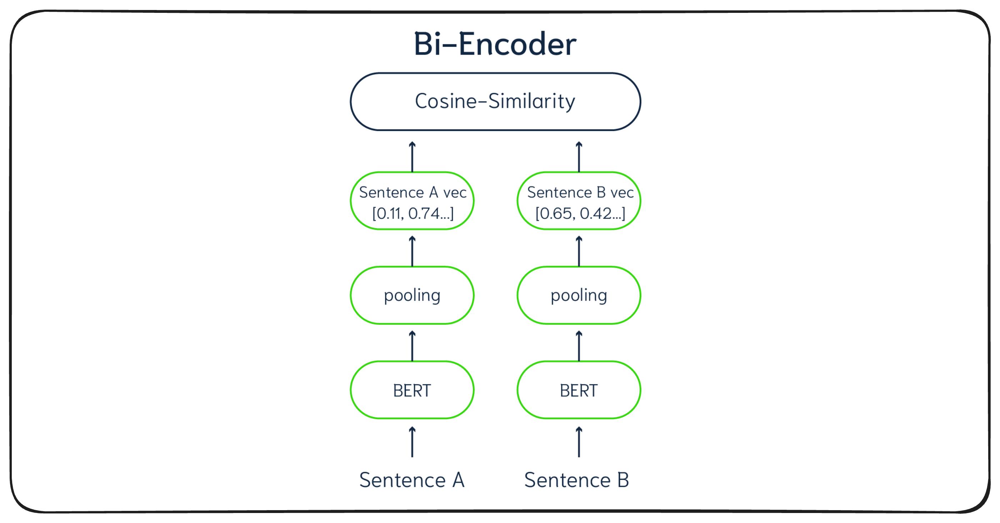```




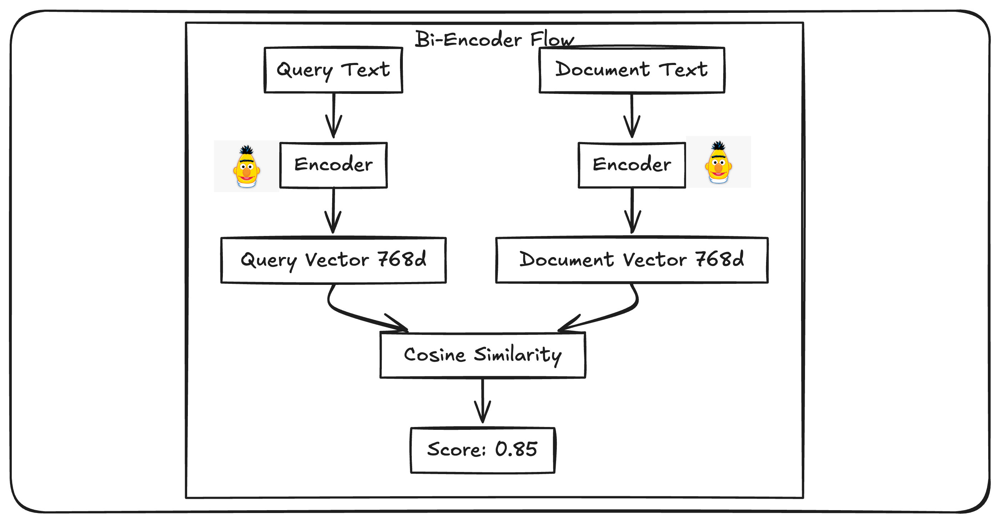

---

### 🔶 Cross-Encoder

**Architecture:**
- Concatenates **query** and **document** into a single input: `[CLS] query [SEP] document [SEP]`
- Full attention between query and document tokens
- Outputs a single relevance score

**Strengths:**
- ✅ **Higher accuracy** — full token-level interaction
- ✅ **Better at capturing nuanced relevance**
- ✅ **Excellent for re-ranking** a small candidate set

**Weaknesses:**
- ❌ **Slow** — must process query+document pairs at inference
- ❌ **Not scalable** for first-stage retrieval

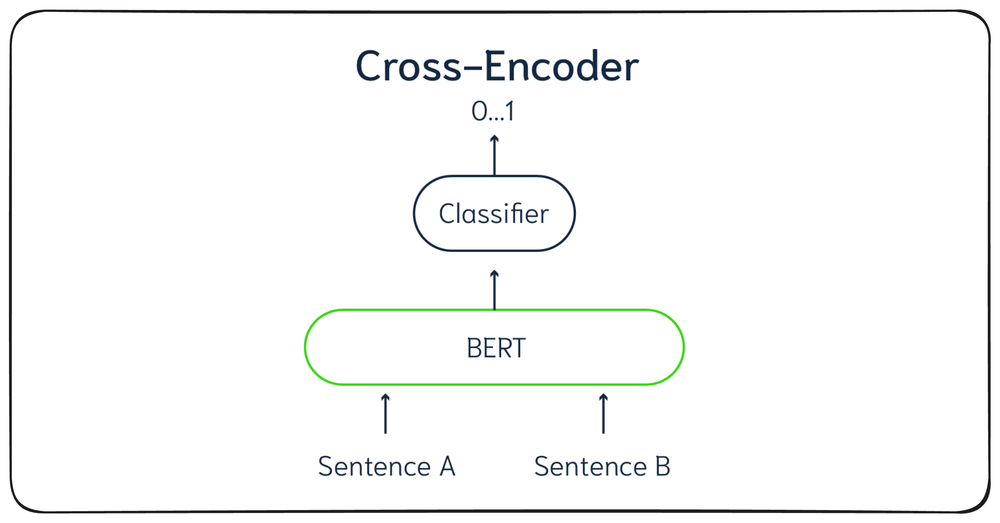



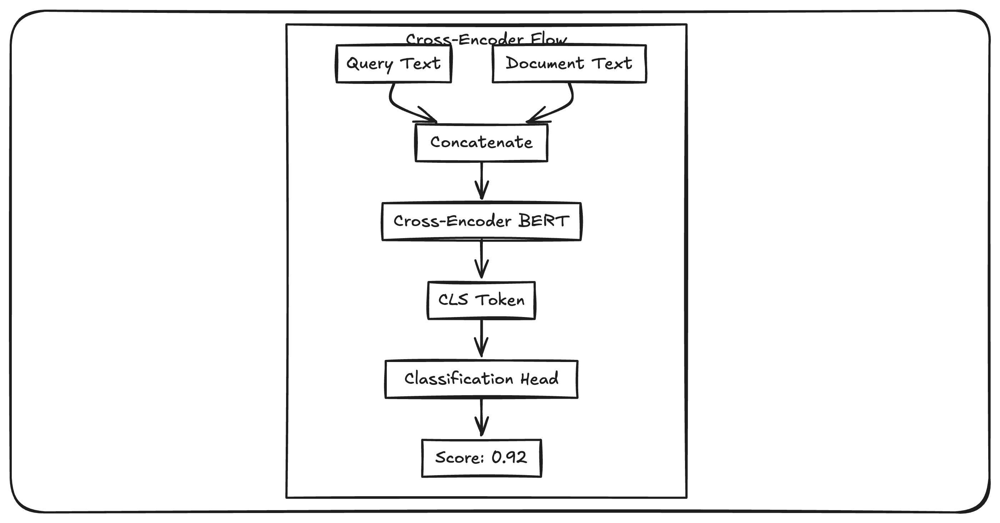

---

### 🔄 Two-Stage Retrieval Pipeline

In production RAG systems, we typically combine both:

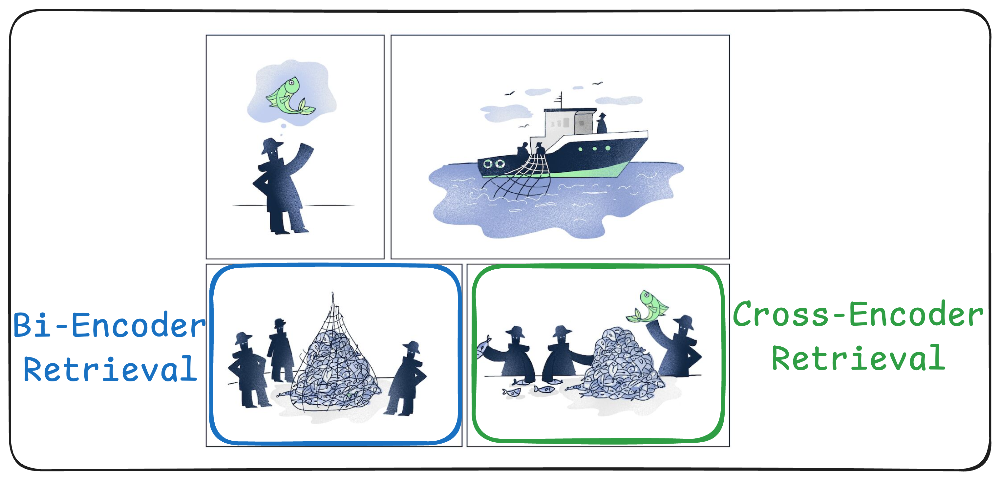

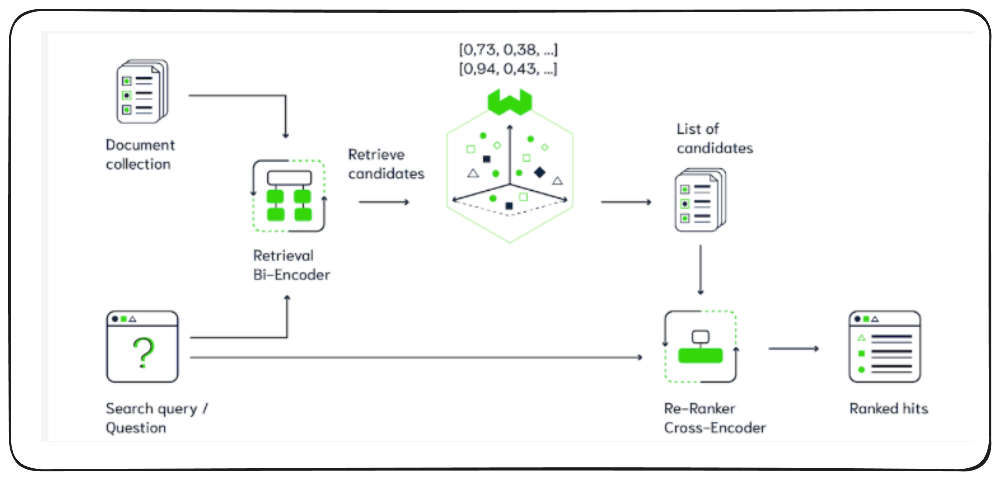

## Why Pretrained Embeddings Aren't Enough — and Why Fine-Tuning Matters

**Pretrained embedding models encode general-world semantics, but real-world retrieval systems operate in specific domains where that generality becomes a liability — fine-tuning bridges this gap by reshaping the embedding space to reflect your data's actual semantic relationships.**

### The Domain Mismatch Problem

Pretrained embedding models are trained on massive general-purpose corpora: Wikipedia, web crawls, book collections. This gives them broad coverage but shallow depth. When you deploy these models in specialized domains — legal, medical, financial, or your company's internal knowledge base — they lack the vocabulary and contextual relationships that matter most.

A general-purpose model might understand that "bank" relates to "money," but it won't know that in your organization, "SWIFT" refers to payment messaging rather than speed, or that "exposure" means risk position rather than light sensitivity. These domain-specific semantic relationships are invisible to pretrained models.

### Task Mismatch Degrades Retrieval Quality

Even within a domain, pretrained models optimize for generic similarity rather than your specific retrieval task. The model's notion of "similar" may not align with what constitutes a relevant document for your users' queries.

Consider a support ticket system: a pretrained model might surface documents that share keywords with the query, but miss the actual resolution because it doesn't understand the relationship between problem descriptions and solution patterns in your corpus. The embedding space wasn't shaped by your task's definition of relevance.

### How Fine-Tuning Reshapes the Embedding Space

Fine-tuning doesn't teach the model new facts — it adjusts how the model positions texts relative to each other in vector space. Through contrastive learning, the optimization process:

- **Pulls together** texts that should be considered similar (query-document pairs, semantically equivalent phrases)
- **Pushes apart** texts that should be distinguished (hard negatives, superficially similar but irrelevant content)

This geometric reorganization means that after fine-tuning, your retrieval system's similarity scores actually reflect domain-relevant similarity rather than generic semantic overlap.

### When Fine-Tuning Pays Off

Fine-tuning is worth the investment when:

- Your domain has specialized terminology that pretrained models misinterpret
- Your retrieval task has a specific definition of relevance not captured by general similarity
- You have access to query-document pairs (even a few thousand) that represent your actual use case
- Smaller fine-tuned models could replace larger general-purpose ones, reducing latency and cost

Fine-tuning is **not** the right solution when your retrieval failures stem from chunking strategy, missing keyword matching (use hybrid search), or insufficient model capacity (try a larger base model first).

### The Bottom Line

Pretrained embeddings give you a starting point, not a destination. For production retrieval systems where precision matters, fine-tuning transforms a general-purpose encoder into one that understands your domain's semantic structure — making the difference between "technically similar" and "actually relevant."

### [Reference](https://weaviate.io/blog/fine-tune-embedding-model)

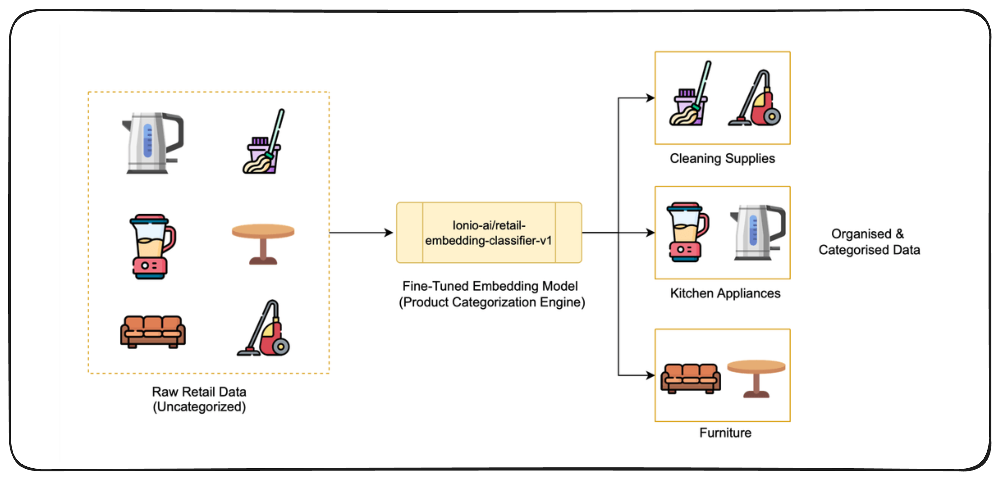

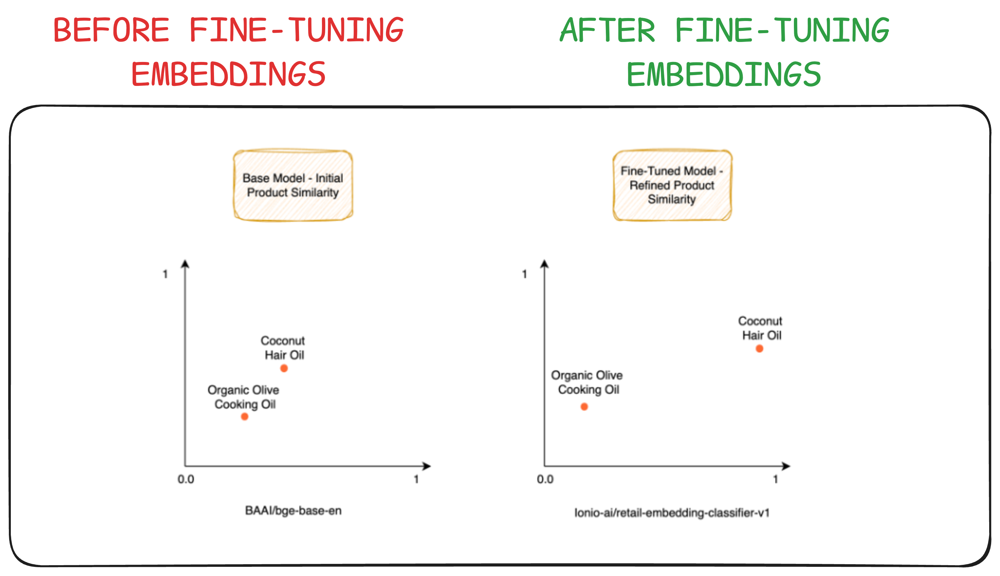

---

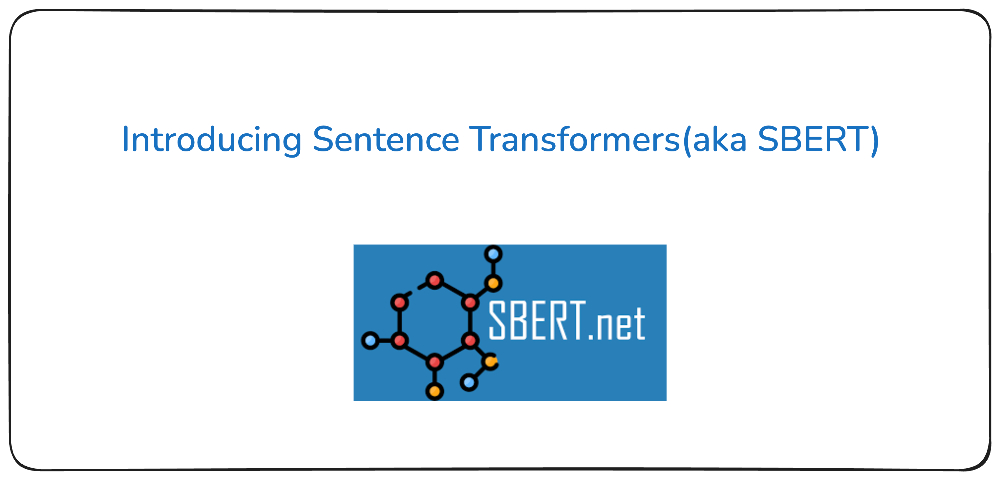

## How Sentence Transformers Came to Be

### The Problem with Vanilla BERT Embeddings

When BERT was released in 2018, it revolutionized NLP by achieving state-of-the-art results on virtually every benchmark. But BERT had a critical limitation for semantic similarity tasks: it wasn't designed to produce meaningful sentence-level embeddings.

To compare two sentences with BERT, you had to feed them *together* into the model as a single input. The model would then output a similarity score for that specific pair. This worked well for accuracy, but it was computationally catastrophic for real-world applications.

Consider a simple task: finding the most similar sentence pair in a collection of 10,000 sentences. With BERT, you'd need to compute similarity for every possible pair — roughly 50 million inference computations. In practice, this took approximately **65 hours** on contemporary hardware. Clustering, semantic search, and information retrieval at any meaningful scale were simply not feasible.

The naive alternative — averaging BERT's token embeddings to create a sentence vector — produced embeddings that performed poorly on similarity tasks, often no better than averaging static word vectors like GloVe.

### The Sentence-BERT Innovation

In 2019, **Nils Reimers** and **Iryna Gurevych** at the UKP Lab (Technische Universität Darmstadt) published "Sentence-BERT: Sentence Embeddings using Siamese BERT-Networks" at EMNLP. Their insight was architectural: instead of feeding sentence pairs into BERT, they modified the training process to make BERT produce meaningful *independent* embeddings for each sentence.

The key innovation was using **siamese and triplet network structures** during fine-tuning:

- **Siamese networks** process two sentences through identical BERT encoders in parallel, then train the model so that similar sentences produce similar embeddings
- **Triplet networks** use an anchor sentence, a positive (similar) sentence, and a negative (dissimilar) sentence, training the model to place the anchor closer to the positive than to the negative in embedding space

After this fine-tuning, each sentence could be encoded *independently* into a fixed-size vector. Similarity between any two sentences became a simple cosine similarity calculation between their pre-computed vectors.

### Why This Changed Everything

The computational impact was dramatic. The same 10,000-sentence similarity search that took 65 hours with BERT now took:

- ~5 seconds to encode all sentences into embeddings
- ~0.01 seconds to compare all pairs using cosine similarity

This wasn't a minor optimization — it was a **four-orders-of-magnitude speedup** that made semantic similarity practical for real applications.

Beyond speed, Sentence-BERT (SBERT) maintained BERT's accuracy advantages. It achieved state-of-the-art results on semantic textual similarity (STS) benchmarks while enabling use cases that were previously impossible:

- **Semantic search** over millions of documents
- **Clustering** of large text collections  
- **Near-duplicate detection** at scale
- **Information retrieval** as the foundation for RAG systems

### The Sentence Transformers Library

Reimers and Gurevych didn't just publish a paper — they released the **sentence-transformers** Python library, making their approach immediately usable. The library provided:

- Pre-trained models ready for inference
- Simple APIs for encoding text and computing similarity
- Training utilities for fine-tuning on custom domains
- Support for various loss functions (triplet loss, contrastive loss, multiple negatives ranking loss)

Since 2019, the library has grown to support over 10,000 pre-trained models on Hugging Face, multilingual embeddings covering 400+ languages, and has become the de facto standard for generating sentence embeddings in production systems. In 2024, the project officially transitioned from UKP Lab to Hugging Face, which had been maintaining it since late 2023.

### The Foundation for Modern Retrieval

Today's bi-encoder architectures — the workhorses of semantic search and RAG retrieval — are direct descendants of the Sentence Transformers approach. When you use a model like `all-MiniLM-L6-v2` or `bge-base-en-v1.5` to encode documents for vector search, you're using the same fundamental insight: train transformers with contrastive objectives to produce embeddings that can be compared independently.

Understanding this history matters because it explains *why* bi-encoders work the way they do, why they need fine-tuning for domain-specific tasks, and why cross-encoders (which still use the original BERT-style pair encoding) remain more accurate but less scalable — a trade-off that motivates the two-stage retrieval pipelines used in production systems today.

### [Reference](https://www.ionio.ai/blog/how-we-fine-tuned-an-embedding-model-to-solve-retail-misclassification-a-complete-guide-code-included)

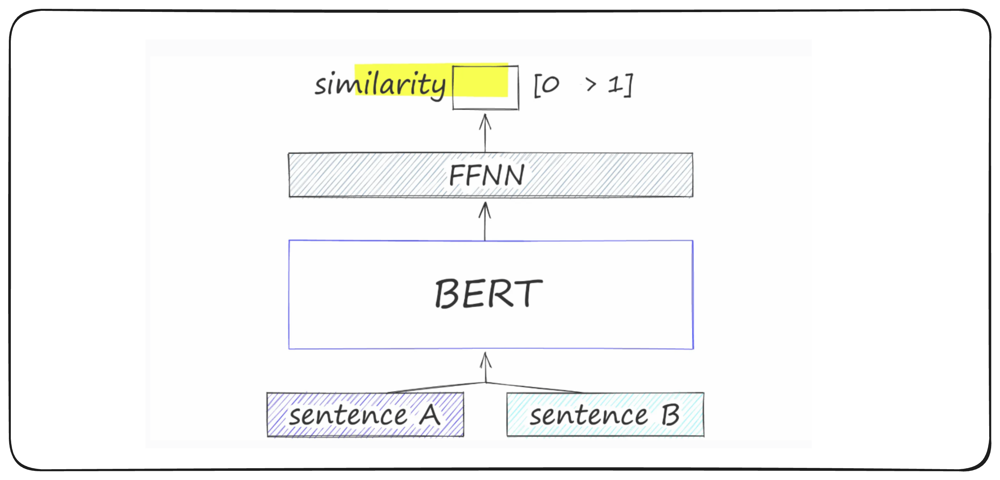

## Why BERT Alone Wasn't Enough — and Why SBERT Was Needed

### The Core Problem: BERT Wasn't Designed for Sentence Embeddings

BERT revolutionized NLP, but it was built for **token-level** tasks — not sentence-level similarity. When you need to compare two sentences with vanilla BERT, you have two options, and neither works well:

**Option 1: Cross-Encoder (Accurate but Unscalable)**

Feed both sentences into BERT together, separated by a special token, and add a classification head to output a similarity score. This produces accurate results, but requires a full BERT inference for *every pair* of sentences you want to compare.

The scalability problem is severe: to find the most similar pair among just 10,000 sentences requires approximately 50 million pairwise comparisons. With BERT's cross-encoder approach, this takes roughly **65 hours**. Clustering 100,000 sentences would require nearly 500 million comparisons — completely impractical for real applications.

**Option 2: Mean Pooling (Fast but Inaccurate)**

Average all of BERT's token embeddings to create a single sentence vector, or use the `[CLS]` token embedding. These vectors can be pre-computed and compared quickly using cosine similarity.

The problem: these embeddings are *not* semantically meaningful. BERT wasn't trained to make averaged token embeddings useful for similarity comparison. In practice, this approach performs worse than averaging GloVe vectors — a method from 2014.

### The Gap SBERT Filled

Before SBERT, you had to choose between **accuracy** (cross-encoders, but impossibly slow) or **speed** (pooled embeddings, but poor quality). There was no way to get both.

SBERT solved this by fine-tuning BERT with a **siamese architecture** specifically designed to produce meaningful sentence embeddings:

- **Same encoder, independent processing**: Each sentence is encoded separately through the same BERT model, producing independent embeddings that can be pre-computed and stored
- **Contrastive training**: The model learns from sentence pairs (using datasets like SNLI and MultiNLI) to produce similar embeddings for semantically similar sentences and dissimilar embeddings for contradictory ones
- **Mean pooling that works**: After fine-tuning, mean pooling over token embeddings actually produces semantically useful sentence vectors

### The Result: Speed Without Sacrificing Quality

The same 10,000-sentence similarity search that took 65 hours with BERT's cross-encoder now takes:

- ~5 seconds to encode all sentences
- ~0.01 seconds to compare all pairs with cosine similarity

SBERT achieved state-of-the-art results on semantic textual similarity benchmarks while enabling practical applications like semantic search, clustering, and retrieval at scale.

### Why This Matters for Retrieval and RAG

Modern retrieval systems and RAG pipelines depend on the ability to:

1. **Pre-compute embeddings** for large document collections
2. **Store embeddings** in vector databases
3. **Compare queries to documents** using fast vector similarity

None of this is possible with BERT's cross-encoder approach. SBERT's bi-encoder architecture made dense retrieval practical, which is why sentence transformers became the foundation for semantic search and the retrieval stage of RAG systems.

The trade-off is that bi-encoders (like SBERT) are slightly less accurate than cross-encoders for any given pair comparison — but they're the only option that scales. This is why modern retrieval pipelines often use bi-encoders for initial retrieval and cross-encoders for re-ranking the top candidates.

## How Sentence Transformers (SBERT) Are Trained

### The Training Goal

The goal of SBERT training is straightforward: take a pretrained transformer (like BERT) that produces token-level representations and fine-tune it to produce **semantically meaningful sentence embeddings** that can be compared using simple cosine similarity.

After training, sentences with similar meanings should have embeddings that are close together in vector space, while sentences with different meanings should be far apart. This geometric property is what makes trained sentence transformers useful for semantic search, clustering, and retrieval.

### Starting Point: Pretrained Transformers

SBERT training doesn't start from scratch. It begins with an already pretrained language model — typically BERT, RoBERTa, or MPNet — that has learned rich linguistic representations from massive text corpora. The fine-tuning process then adapts these representations specifically for sentence-level similarity tasks.

This transfer learning approach is why SBERT training is relatively fast and computationally cheap compared to pretraining from scratch.

### Training Data: Natural Language Inference

The original SBERT and many subsequent models are trained on **Natural Language Inference (NLI)** datasets, particularly:

- **SNLI** (Stanford Natural Language Inference): ~570K sentence pairs
- **MultiNLI** (Multi-Genre NLI): ~430K sentence pairs

NLI datasets contain pairs of sentences (a "premise" and a "hypothesis") labeled with one of three relationships:

- **Entailment**: The hypothesis follows from the premise
- **Neutral**: The hypothesis is unrelated to the premise  
- **Contradiction**: The hypothesis contradicts the premise

This labeling provides a natural training signal: entailment pairs should have similar embeddings, contradiction pairs should have dissimilar embeddings.

### The Siamese Architecture

During training, SBERT uses a **siamese network** structure. Both sentences in a pair are processed through the same transformer encoder (with shared weights), producing independent embeddings for each. These embeddings are then pooled (typically mean pooling over token embeddings) to create fixed-size sentence vectors.

The key insight is that by training the model to predict relationships between sentence pairs while keeping the encoders identical, the model learns to produce embeddings where similarity can be measured directly — without needing to feed both sentences through the model together.

### Loss Functions: Teaching Similarity

Several loss functions can be used to train sentence transformers, each with different data requirements:

**Softmax Loss (Original SBERT)**  
The original approach concatenates the two sentence embeddings along with their element-wise difference, then passes this combined vector through a softmax classifier to predict the NLI label (entailment/neutral/contradiction). While this works, it's no longer the preferred method.

**Triplet Loss**  
Uses triplets of (anchor, positive, negative) sentences. The model learns to make the anchor embedding closer to the positive than to the negative by at least a specified margin. For NLI data, entailment pairs provide positives and contradiction pairs provide hard negatives.

**Multiple Negatives Ranking Loss (MNR)**  
The current best practice. Given pairs of (anchor, positive) sentences, the model treats all other positives in the training batch as negatives. This "in-batch negative sampling" provides a strong training signal without requiring explicit negative examples. Larger batch sizes mean more negatives and better gradients.

**Contrastive Loss**  
Directly optimizes for similar pairs to have high cosine similarity and dissimilar pairs to have low similarity, using a margin to define the boundary.

### What Training Changes

Before training, a vanilla BERT produces token embeddings that aren't optimized for sentence-level comparison. Averaging these embeddings often produces poor similarity scores — sometimes no better than random.

After SBERT training, the model has learned to:

1. **Compress sentence meaning** into the embedding space in a way that preserves semantic relationships
2. **Position similar sentences nearby** in vector space
3. **Separate dissimilar sentences** by pushing them apart

The embedding space becomes geometrically organized by meaning, making cosine similarity a reliable proxy for semantic similarity.

### Beyond NLI: Domain-Specific Training

While NLI provides a strong general-purpose starting point, the same training methodology applies to domain-specific data:

- **Semantic Textual Similarity (STS)** datasets provide sentence pairs with continuous similarity scores
- **Paraphrase datasets** provide positive pairs of semantically equivalent sentences
- **Custom query-document pairs** from your domain can fine-tune models for specific retrieval tasks

The loss function choice depends on your data format: pairs work with MNR loss, triplets work with triplet loss, and scored pairs work with regression-based losses.

### The Result

A trained sentence transformer converts any input text into a dense vector where:

- **Semantic similarity** correlates with **cosine similarity**
- Embeddings can be **computed independently** for each text
- Similarity search reduces to **nearest neighbor lookup** in vector space

This is what makes sentence transformers the foundation for scalable semantic search, retrieval-augmented generation, and the bi-encoder architectures used throughout modern NLP systems.

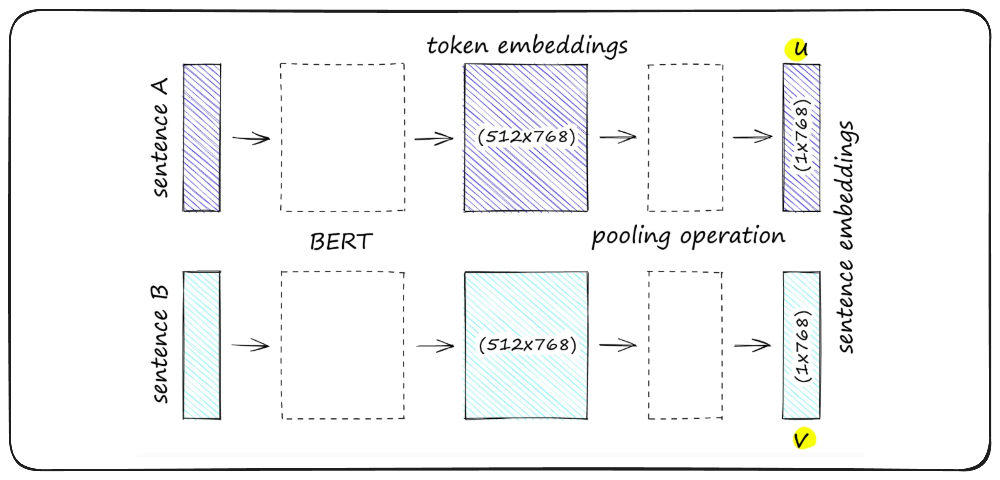

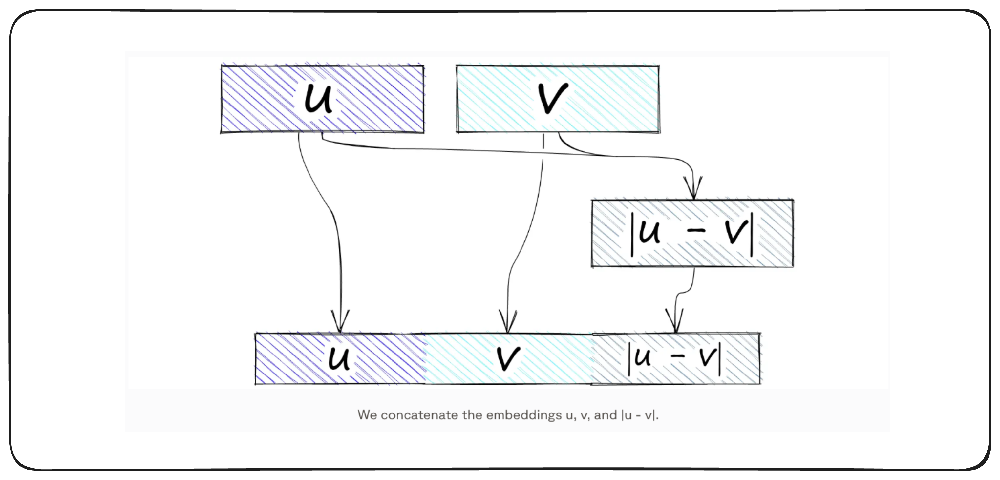

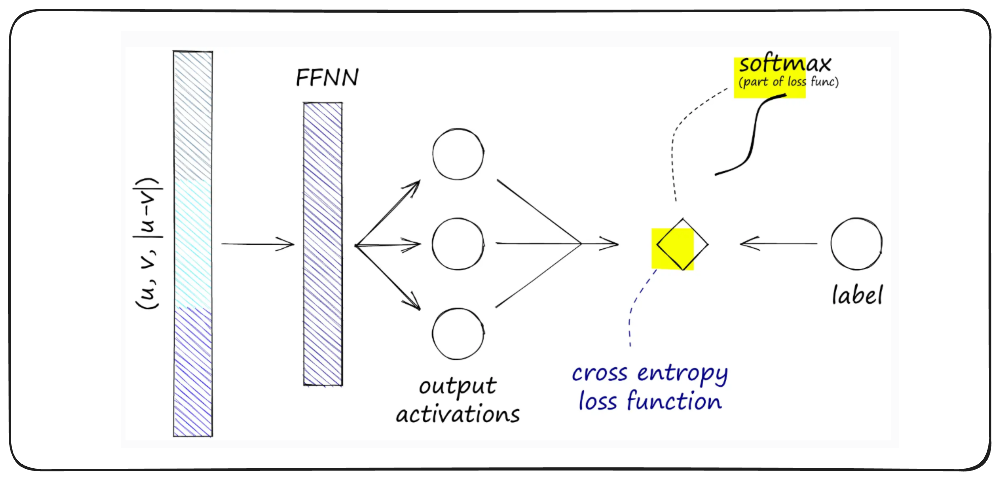

### [Reference](https://www.pinecone.io/learn/series/nlp/sentence-embeddings/)

---

<a id="2-setup"></a>
## 2. Environment Setup

Let's install all required dependencies.

In [ ]:
# Install required packages
!pip install -q sentence-transformers>=3.0.0
!pip install -q datasets
!pip install -q opik
!pip install -q faiss-cpu
!pip install -q langchain langchain-community langchain-huggingface
!pip install -q torch
!pip install -q tqdm pandas numpy
!pip install -q tensorboard
!pip install -q openai

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 152.8/152.8 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 41.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.8/69.8 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 109.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 88.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 278.1/278.1 kB 19.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.5/42.5 kB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.8/23.8 MB 111.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.5/2.5 MB 54.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 70.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.7/64.7 kB 6.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 51.0/51.0 kB 4

In [ ]:
# Core imports
import torch
import numpy as np
import pandas as pd
from tqdm.auto import tqdm
import warnings
warnings.filterwarnings('ignore')

# Dataset
from datasets import load_dataset

# SentenceTransformers
from sentence_transformers import (
    SentenceTransformer,
    InputExample,
    losses,
    evaluation
)
from sentence_transformers.cross_encoder import CrossEncoder
from sentence_transformers.cross_encoder.evaluation import CERerankingEvaluator
from torch.utils.data import DataLoader

# Evaluation
import opik
from opik import track, opik_context

# Vector store
import faiss

# Set device
device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"Using device: {device}")

Using device: cuda


In [ ]:
# Initialize Opik for experiment tracking
# Note: Configure your Opik API key if using cloud version
# opik.configure(api_key="YOUR_API_KEY")

# For local/demo usage, Opik can run without configuration
print("Opik initialized for experiment tracking")

Opik initialized for experiment tracking


---

<a id="3-dataset"></a>
## 3. Dataset Overview

We'll use the **RAG Human Rights dataset** from Hugging Face, which contains queries with relevant (positive) and irrelevant (negative) documents — perfect for training retrieval models.

### Dataset: `sdiazlor/rag-human-rights-from-files`

In [ ]:
# Load the dataset
dataset = load_dataset("sdiazlor/rag-human-rights-from-files")
print(f"Dataset splits: {list(dataset.keys())}")
print(f"\nDataset structure:")
print(dataset)

README.md: 0.00B [00:00, ?B/s]

data/train-00000-of-00001.parquet:   0%|          | 0.00/340k [00:00<?, ?B/s]

Generating train split:   0%|          | 0/500 [00:00<?, ? examples/s]

Dataset splits: ['train']

Dataset structure:
DatasetDict({
    train: Dataset({
        features: ['context', 'question', 'response', 'positive_retrieval', 'negative_retrieval', 'positive_reranking', 'negative_reranking'],
        num_rows: 500
    })
})


In [ ]:
# Convert to pandas for easier manipulation
df = dataset["train"].to_pandas()

# Display first few rows
df.head()

,context,question,response,positive_retrieval,negative_retrieval,positive_reranking,negative_reranking
0,Universal Declaration of Human Rights\n\nPreamble,What is the preamble of the Universal Declarat...,The preamble of the Universal Declaration of H...,What is the preamble of the Universal Declarat...,The preamble of the Magna Carta is a fundament...,The international community has come together ...,The Universal Declaration of Human Rights serv...
1,Whereas recognition of the inherent dignity an...,Is the recognition of the inherent dignity and...,"Yes, according to the document, the recognitio...",Is the recognition of the inherent dignity and...,Whereas recognition of the inherent dignity an...,While recognition of the inherent moral obliga...,While recognition of the inherent moral obliga...
2,"people,\n\nWhereas it is essential, if man is ...",What are the essential steps to protect human ...,The document does not explicitly state the ess...,What are the essential steps to protect human ...,Whereas it is essential to promote the develop...,The United Nations emphasizes the importance o...,The United Nations has reaffirmed its faith in...
3,and in the equal rights of men and women and h...,What social and economic progress and better l...,The document does not explicitly state the spe...,What social and economic progress and better l...,Whereas a common understanding of these rights...,The international community has agreed to upho...,The international community has agreed to upho...
4,"The General Assembly,\n\nProclaims this Univer...",What is the purpose of the Universal Declarati...,The purpose of the Universal Declaration of Hu...,What is the purpose of the Universal Declarati...,The General Council of the United World Organi...,"The General Assembly,\n\nProclaims this resolu...","The General Assembly,\n\nProclaims this resolu..."


In [ ]:
# Explore the data structure
train_data = dataset['train']
print(f"Number of training examples: {len(train_data)}")
print(f"\nColumn names: {train_data.column_names}")
print(f"\n--- Sample Entry ---")
sample = train_data[0]
for key, value in sample.items():
    print(f"\n{key}:")
    if isinstance(value, str):
        print(f"  {value[:200]}..." if len(value) > 200 else f"  {value}")
    else:
        print(f"  {value}")

Number of training examples: 500

Column names: ['context', 'question', 'response', 'positive_retrieval', 'negative_retrieval', 'positive_reranking', 'negative_reranking']

--- Sample Entry ---

context:
  Universal Declaration of Human Rights

Preamble

question:
  What is the preamble of the Universal Declaration of Human Rights?

response:
  The preamble of the Universal Declaration of Human Rights. 

The preamble to the Universal Declaration of Human Rights states:

"Whereas recognition of the inherent dignity and of the equal and inalie...

positive_retrieval:
  What is the preamble of the Universal Declaration of Human Rights?

negative_retrieval:
  The preamble of the Magna Carta is a fundamental document that sets the groundwork for the development of human rights.

positive_reranking:
  The international community has come together to recognize the inherent dignity and equal rights of all individuals as a foundation for a just and peaceful world.

negative_reranking:
  The Uni

### 📊 Data Flow Visualization

The following table shows exactly what data goes into each model architecture:

| Component | Input Format | Output | Use Case |
|-----------|-------------|--------|----------|
| **Bi-Encoder (Query)** | `"What are human rights?"` | `[768-dim vector]` | Encode query independently |
| **Bi-Encoder (Document)** | `"Human rights are fundamental freedoms..."` | `[768-dim vector]` | Pre-compute document embeddings |
| **Bi-Encoder Similarity** | `query_vec ⊙ doc_vec` | `0.85` (float) | Fast similarity search |
| **Cross-Encoder** | `"[CLS] What are human rights? [SEP] Human rights are fundamental freedoms... [SEP]"` | `0.92` (float) | Direct relevance scoring |





In [ ]:
# Prepare data for training
# We need to structure data differently for Bi-Encoder vs Cross-Encoder

def prepare_training_data(dataset_split, max_samples=1000):
    """
    Prepare training data in formats suitable for both model types.

    Returns:
        bi_encoder_examples: List of InputExample with (anchor, positive, negative)
        cross_encoder_examples: List of (query, document, label) tuples
        eval_queries: Dict for evaluation
    """
    bi_encoder_examples = []
    cross_encoder_examples = []

    # Limit samples for demo purposes
    samples = list(dataset_split)[:max_samples]

    for item in tqdm(samples, desc="Preparing data"):
        query = item.get('question', item.get('query', ''))
        positive_doc = item.get('context', item.get('positive', ''))

        # Skip if missing required fields
        if not query or not positive_doc:
            continue

        # For Bi-Encoder with Triplet Loss, we need: anchor, positive, negative
        # We'll create hard negatives by using other documents
        bi_encoder_examples.append(
            InputExample(texts=[query, positive_doc])
        )

        # For Cross-Encoder: (query, document, relevance_label)
        # Positive pair (label = 1)
        cross_encoder_examples.append(
            InputExample(texts=[query, positive_doc], label=1.0)
        )

    # Create negative examples for Cross-Encoder by pairing with random documents
    docs = [item.get('context', item.get('positive', '')) for item in samples if item.get('context') or item.get('positive')]
    queries = [item.get('question', item.get('query', '')) for item in samples if item.get('question') or item.get('query')]

    np.random.seed(42)
    for i, query in enumerate(queries[:len(cross_encoder_examples)]):
        # Pick a random document that's not the positive
        neg_idx = np.random.randint(0, len(docs))
        while neg_idx == i:
            neg_idx = np.random.randint(0, len(docs))
        cross_encoder_examples.append(
            InputExample(texts=[query, docs[neg_idx]], label=0.0)
        )

    return bi_encoder_examples, cross_encoder_examples, queries, docs

# Prepare the data
bi_encoder_train, cross_encoder_train, eval_queries, corpus_docs = prepare_training_data(
    dataset['train'],
    max_samples=500  # Reduced for demo speed
)

print(f"\n✅ Data Preparation Complete")
print(f"   Bi-Encoder training examples: {len(bi_encoder_train)}")
print(f"   Cross-Encoder training examples: {len(cross_encoder_train)}")
print(f"   Evaluation queries: {len(eval_queries)}")
print(f"   Corpus documents: {len(corpus_docs)}")

Preparing data:   0%|          | 0/500 [00:00<?, ?it/s]


✅ Data Preparation Complete
   Bi-Encoder training examples: 500
   Cross-Encoder training examples: 1000
   Evaluation queries: 500
   Corpus documents: 500


In [ ]:
print("\n🔷 Bi-Encoder Input (Query, Positive Document):")
print("-" * 40)
sample_bi = bi_encoder_train[0]
print(f"Query: {sample_bi.texts[0][:500]}...")
print("-" * 40)
print(f"Document: {sample_bi.texts[1][:1000]}...")
print("--truncated--")
print("-" * 40)



🔷 Bi-Encoder Input (Query, Positive Document):
----------------------------------------
Query: What is the preamble of the Universal Declaration of Human Rights?...
----------------------------------------
Document: Universal Declaration of Human Rights

Preamble...
--truncated--
----------------------------------------


In [ ]:
print("\n🔶 Cross-Encoder Input (Query + Document concatenated):")
print("-" * 40)
sample_ce = cross_encoder_train[0]
print(f"Input: [CLS] {sample_ce.texts[0][:50]}... [SEP] {sample_ce.texts[1][:50]}... [SEP]")
print("-" * 40)
print(f"Label: {sample_ce.label} (1.0 = relevant, 0.0 = not relevant)")
print("-" * 40)


🔶 Cross-Encoder Input (Query + Document concatenated):
----------------------------------------
Input: [CLS] What is the preamble of the Universal Declaration ... [SEP] Universal Declaration of Human Rights

Preamble... [SEP]
----------------------------------------
Label: 1.0 (1.0 = relevant, 0.0 = not relevant)
----------------------------------------


In [ ]:
# Create train/eval split for validation during training
from sklearn.model_selection import train_test_split

# Split queries and docs
train_queries, eval_queries_split, train_docs, eval_docs_split = train_test_split(
    eval_queries[:400], corpus_docs[:400], test_size=0.2, random_state=42
)

print(f"✅ Train: {len(train_queries)} queries | Eval: {len(eval_queries_split)} queries")

✅ Train: 320 queries | Eval: 80 queries


---

<a id="4-default-bi-encoder"></a>
## 4. Default Bi-Encoder Evaluation

### Experiment A (Part 1): Evaluate Pre-trained Bi-Encoder

We'll use `all-MiniLM-L6-v2`, a popular and efficient sentence transformer model.

In [ ]:
# Load pre-trained Bi-Encoder
DEFAULT_BI_ENCODER_MODEL = "sentence-transformers/all-MiniLM-L6-v2"

bi_encoder_default = SentenceTransformer(DEFAULT_BI_ENCODER_MODEL, device=device)
print(f"✅ Loaded default Bi-Encoder: {DEFAULT_BI_ENCODER_MODEL}")
print(f"   Embedding dimension: {bi_encoder_default.get_sentence_embedding_dimension()}")

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

✅ Loaded default Bi-Encoder: sentence-transformers/all-MiniLM-L6-v2
   Embedding dimension: 384


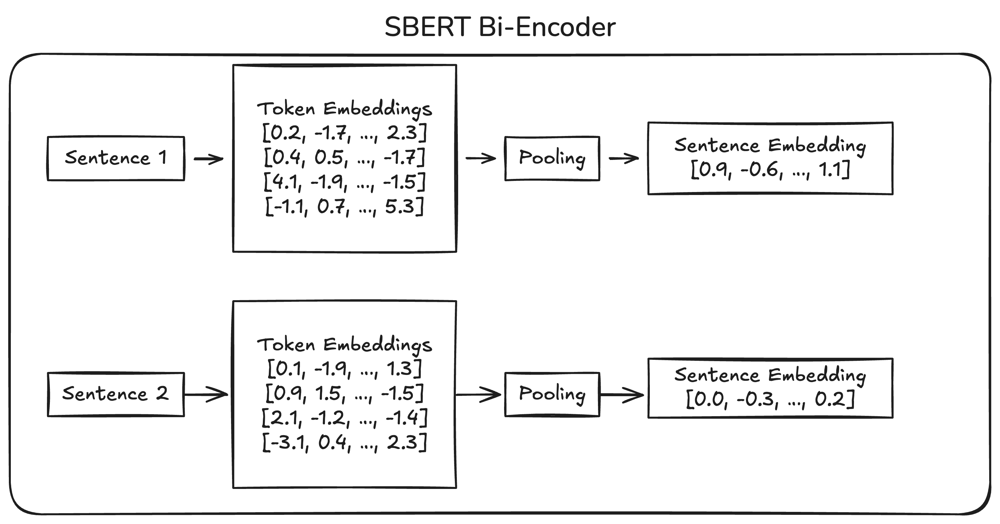

In [ ]:
# Demonstrate Bi-Encoder encoding
print("🔷 Bi-Encoder: Independent Encoding Demo")
print("=" * 50)

demo_query = "What are the fundamental human rights?"
demo_doc = "Human rights are rights inherent to all human beings, regardless of race, sex, nationality, ethnicity, language, religion, or any other status."

# Encode independently
query_embedding = bi_encoder_default.encode(demo_query, convert_to_tensor=True)
doc_embedding = bi_encoder_default.encode(demo_doc, convert_to_tensor=True)

print(f"Query: '{demo_query}'")
print(f"Query embedding shape: {query_embedding.shape}")
print(f"\nDocument: '{demo_doc[:80]}...'")
print(f"Document embedding shape: {doc_embedding.shape}")

# Compute similarity
from sentence_transformers import util
similarity = util.cos_sim(query_embedding, doc_embedding).item()
print(f"\n📊 Cosine Similarity: {similarity:.4f}")

🔷 Bi-Encoder: Independent Encoding Demo
Query: 'What are the fundamental human rights?'
Query embedding shape: torch.Size([384])

Document: 'Human rights are rights inherent to all human beings, regardless of race, sex, n...'
Document embedding shape: torch.Size([384])

📊 Cosine Similarity: 0.7741


In [ ]:
# Build FAISS index for fast retrieval
def build_faiss_index(model, documents, batch_size=32):
    """Create a FAISS index from document embeddings."""
    print("Encoding documents...")
    doc_embeddings = model.encode(
        documents,
        batch_size=batch_size,
        show_progress_bar=True,
        convert_to_numpy=True
    )

    # Normalize for cosine similarity
    faiss.normalize_L2(doc_embeddings)

    # Create index
    dimension = doc_embeddings.shape[1]
    index = faiss.IndexFlatIP(dimension)  # Inner product (cosine sim for normalized vectors)
    index.add(doc_embeddings)

    print(f"✅ FAISS index built with {index.ntotal} documents")
    return index, doc_embeddings

# Build index with default model
default_index, default_doc_embeddings = build_faiss_index(bi_encoder_default, corpus_docs)

Encoding documents...


Batches:   0%|          | 0/16 [00:00<?, ?it/s]

✅ FAISS index built with 500 documents


In [ ]:
# Retrieval function
def retrieve_documents(model, index, query, documents, top_k=10):
    """Retrieve top-k documents for a query using FAISS."""
    # Encode query
    query_embedding = model.encode([query], convert_to_numpy=True)
    faiss.normalize_L2(query_embedding)

    # Distance/CS based Search
    scores, indices = index.search(query_embedding, top_k) #Retreive top k docs based on CS

    results = []
    for score, idx in zip(scores[0], indices[0]):
        results.append({
            'document': documents[idx],
            'score': float(score),
            'index': int(idx)
        })

    return results

# Test retrieval
test_query = eval_queries[0]
print(f"Query: {test_query[:100]}...\n")
print("Top-5 Retrieved Documents (Default Bi-Encoder):")
print("-" * 50)

results = retrieve_documents(bi_encoder_default, default_index, test_query, corpus_docs, top_k=5)
for i, res in enumerate(results):
    print(f"\n{i+1}. Score: {res['score']:.4f}")
    print(f"   Doc: {res['document'][:700]}...")

Query: What is the preamble of the Universal Declaration of Human Rights?...

Top-5 Retrieved Documents (Default Bi-Encoder):
--------------------------------------------------

1. Score: 0.9279
   Doc: Universal Declaration of Human Rights

Preamble...

2. Score: 0.7054
   Doc: The General Assembly,

Proclaims this Universal Declaration of Human Rights as a common standard of

achievement for all peoples and all nations, to the end that every individual and

every organ of society, keeping this Declaration constantly in mind, shall strive by

teaching and education to promote respect for these rights and freedoms and by

progressive measures, national and international, to secure their universal and...

3. Score: 0.7054
   Doc: The General Assembly,

Proclaims this Universal Declaration of Human Rights as a common standard of

achievement for all peoples and all nations, to the end that every individual and

every organ of society, keeping this Declaration constantly in mind, shall st

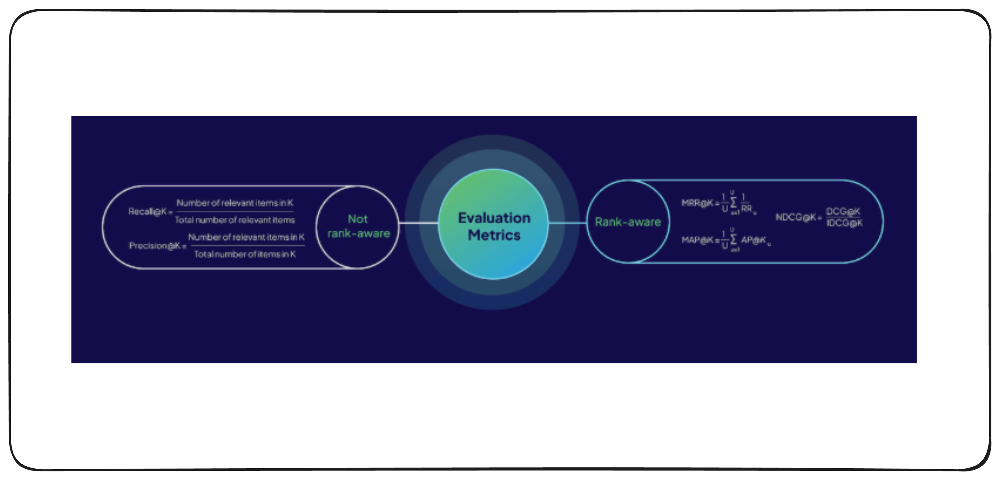

## Retrieval Evaluation Metrics — A Practical Primer

Before evaluating retrieval systems, you need to understand *what* you're measuring. Different metrics answer different questions about your system's performance. This primer covers the essential metrics you'll encounter when building and evaluating RAG pipelines, search systems, and recommendation engines.

All metrics below use the "@K" notation (e.g., Recall@10), meaning we only evaluate the top K results returned by the system.

---

### Precision@K

**Purpose:** Measures how many of the retrieved results are actually relevant.

**Use case:** Use precision when you care about avoiding irrelevant results in your top K. High precision means users see mostly relevant content — important when screen real estate is limited or when irrelevant results have a cost (e.g., user frustration, wasted LLM tokens in RAG).

**Intuition:** If you retrieve 10 documents and 7 are relevant, your Precision@10 is 0.7. This metric answers: "Of what I returned, how much was useful?"

**Limitation:** Precision doesn't consider how many relevant documents exist in total — only what you returned.

---
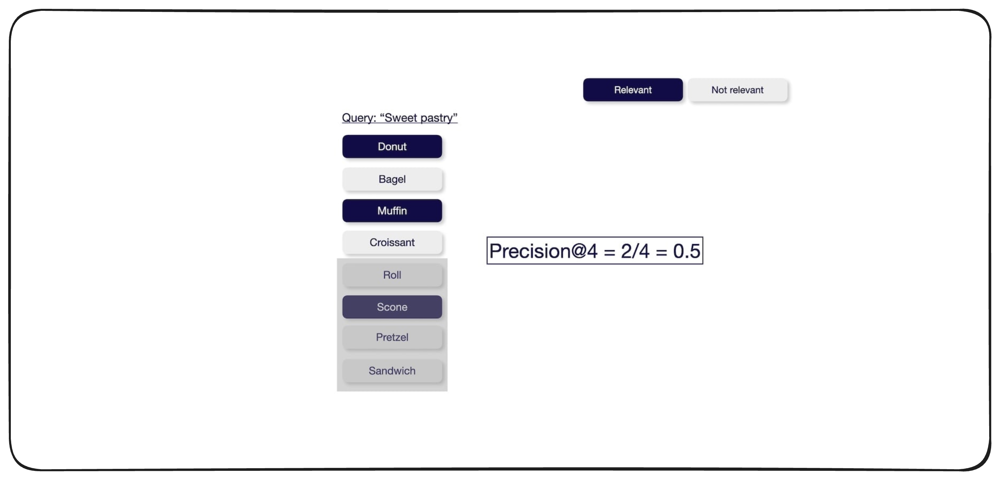


### Recall@K

**Purpose:** Measures how many of the total relevant documents were successfully retrieved.

**Use case:** Use recall when missing relevant documents is costly. In RAG systems, low recall means the LLM might not have access to critical information. In legal or medical search, missing a relevant document could have serious consequences.

**Intuition:** If there are 5 relevant documents in your corpus and you retrieve 3 of them in your top 10, your Recall@10 is 0.6. This metric answers: "Of everything I should have found, how much did I actually find?"

**Limitation:** Recall doesn't penalize returning irrelevant results — you could return the entire corpus and achieve perfect recall.

---
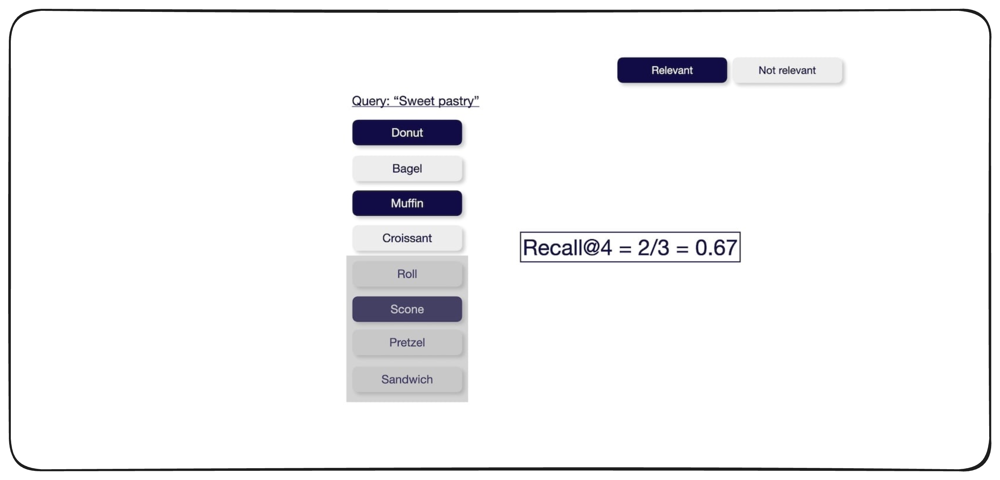


### Hits@K (Success@K)

**Purpose:** Measures whether *at least one* relevant document appears in the top K results.

**Use case:** Use Hits@K when you only need one good result to succeed — common in question-answering systems where a single relevant passage is sufficient to generate an answer.

**Intuition:** Hits@K is binary: either a relevant document is present in the top K (score = 1) or it isn't (score = 0). When averaged across queries, it tells you the percentage of queries where the system found at least one relevant result.

**Limitation:** Doesn't distinguish between finding 1 vs. 5 relevant documents, and ignores ranking position.

---

### Mean Reciprocal Rank (MRR@K)

**Purpose:** Measures how quickly the system surfaces the *first* relevant result.

**Use case:** Use MRR when the position of the first relevant result matters most. This is common in navigational search (finding a specific page) or when users typically only look at the top few results.

**Intuition:** If the first relevant document is at position 1, the reciprocal rank is 1.0. At position 2, it's 0.5. At position 3, it's 0.33. MRR averages this across all queries. A high MRR means relevant results consistently appear near the top.

**Limitation:** Only considers the first relevant result — ignores subsequent relevant documents entirely.

---
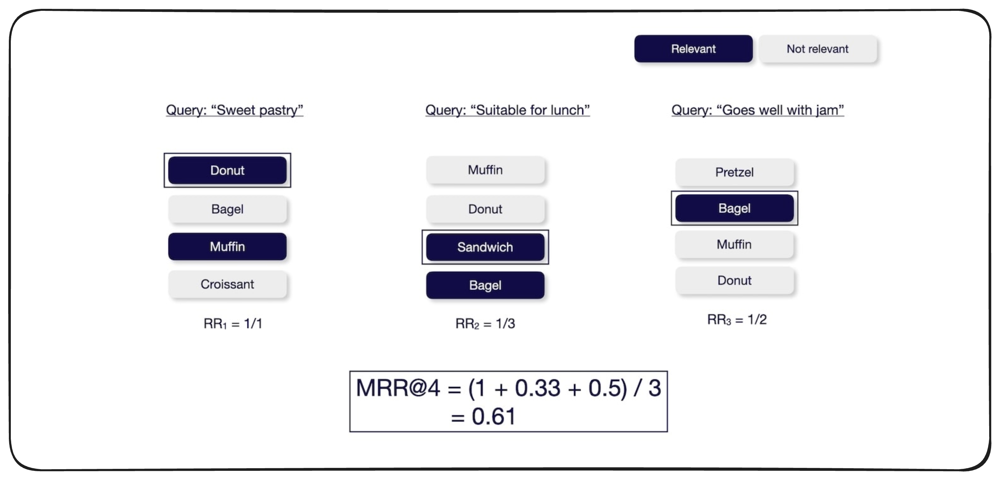


### Mean Average Precision (MAP@K)

**Purpose:** Measures both the number of relevant results and their ranking positions, rewarding systems that place relevant documents higher.

**Use case:** Use MAP when you care about the entire ranked list, not just the first result. It's particularly useful when multiple relevant documents exist and their positions all matter. MAP is the standard metric for evaluating reranking systems on the MTEB benchmark.

**Intuition:** MAP calculates precision at each position where a relevant document appears, then averages these values. A system that ranks all relevant documents at positions 1, 2, 3 scores higher than one that places them at positions 1, 5, 10 — even though both retrieved the same documents.

**Limitation:** Treats all relevant documents as equally important (binary relevance).

---

### Normalized Discounted Cumulative Gain (NDCG@K)

**Purpose:** Measures ranking quality when relevance comes in grades (e.g., highly relevant, somewhat relevant, not relevant).

**Use case:** Use NDCG when documents have varying degrees of relevance, not just binary relevant/irrelevant labels. This is the standard metric for evaluating retrieval systems on the MTEB benchmark and is common in search engines where some results are "better" than others.

**Intuition:** NDCG gives more credit for placing highly relevant documents at the top and applies a logarithmic discount to lower positions. A score of 1.0 means perfect ranking (ideal ordering), while lower scores indicate suboptimal ordering. The "normalized" part means scores are comparable across queries with different numbers of relevant documents.

**Limitation:** Requires graded relevance labels, which are more expensive to annotate than binary labels.

---
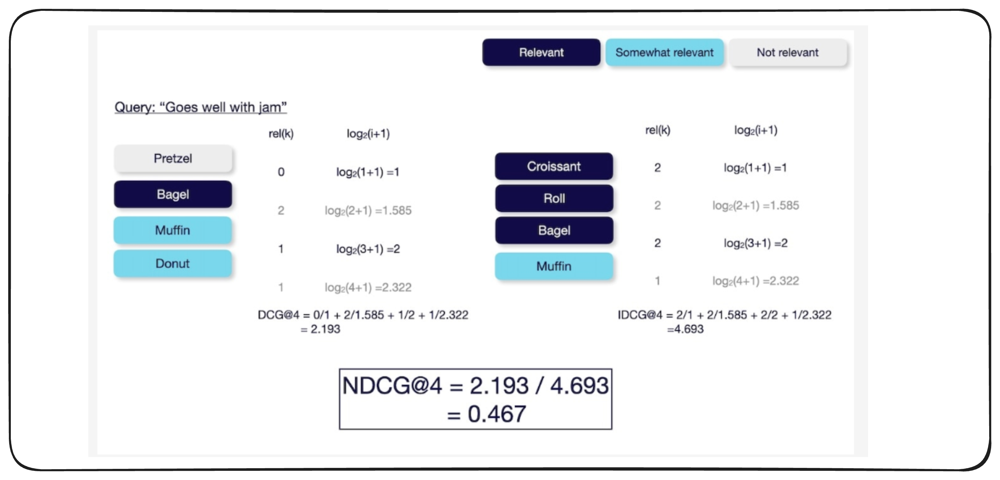
### Quick Reference: Choosing the Right Metric

| Metric | Rank-Aware? | Relevance Type | Best For |
|--------|-------------|----------------|----------|
| **Precision@K** | No | Binary | Avoiding noise in results |
| **Recall@K** | No | Binary | Ensuring coverage of relevant docs |
| **Hits@K** | No | Binary | Single-answer retrieval (Q&A) |
| **MRR@K** | Yes (first only) | Binary | Navigational search, top-1 matters |
| **MAP@K** | Yes (all positions) | Binary | Reranking evaluation, full list quality |
| **NDCG@K** | Yes (all positions) | Graded | Retrieval with varying relevance levels |

---

### Practical Guidance

For most RAG systems, start with **Recall@K** (to ensure you're finding relevant context) and **MRR@K** (to ensure relevant context appears early). If you're building a reranker or need to compare full ranked lists, add **MAP@K** or **NDCG@K**.

Remember: no single metric tells the whole story. A system with high recall but low precision floods your LLM with irrelevant context. A system with high precision but low recall might miss critical information. Evaluate with multiple metrics and choose the balance that fits your application's needs.

### [Reference](https://weaviate.io/blog/retrieval-evaluation-metrics)

In [ ]:
# Evaluate Default Bi-Encoder and log to Opik
@track(name="evaluate_bi_encoder")
def evaluate_bi_encoder(model, index, queries, corpus, relevant_docs, k_values=[1, 5, 10]):
    """
    Evaluate Bi-Encoder retrieval performance.

    Metrics:
    - Recall@K: Fraction of relevant docs retrieved in top-K
    - MRR (Mean Reciprocal Rank): Average of 1/rank of first relevant doc
    """
    metrics = {f'recall@{k}': [] for k in k_values}
    metrics['mrr'] = []

    max_k = max(k_values)

    for i, query in enumerate(tqdm(queries[:100], desc="Evaluating")):
        # Get ground truth (for this demo, assume doc at same index is relevant)
        relevant_idx = i

        # Retrieve
        results = retrieve_documents(model, index, query, corpus, top_k=max_k)
        retrieved_indices = [r['index'] for r in results]

        # Calculate Recall@K
        for k in k_values:
            recall = 1.0 if relevant_idx in retrieved_indices[:k] else 0.0
            metrics[f'recall@{k}'].append(recall)

        # Calculate MRR
        if relevant_idx in retrieved_indices:
            rank = retrieved_indices.index(relevant_idx) + 1
            metrics['mrr'].append(1.0 / rank)
        else:
            metrics['mrr'].append(0.0)

    # Aggregate metrics
    final_metrics = {k: np.mean(v) for k, v in metrics.items()}

    # Log to Opik
    opik_context.update_current_trace(metadata={"model_type": "bi_encoder"})
    for metric_name, metric_value in final_metrics.items():
        opik_context.update_current_trace(metadata={metric_name: metric_value})

    return final_metrics

# Run evaluation
print("📊 Evaluating Default Bi-Encoder...")
default_bi_metrics = evaluate_bi_encoder(
    bi_encoder_default,
    default_index,
    eval_queries,
    corpus_docs,
    None  # Using index-based relevance for demo
)

print("\n✅ Default Bi-Encoder Metrics:")
for metric, value in default_bi_metrics.items():
    print(f"   {metric}: {value:.4f}")

OPIK: ========================
The API key must be specified to log data to https://www.comet.com/opik.
You can use `opik configure` CLI command to configure your environment for logging.
See the configuration details in the docs: https://www.comet.com/docs/opik/tracing/sdk_configuration.


OPIK: Started logging traces to the "Default Project" project at https://www.comet.com/opik/api/v1/session/redirect/projects/?trace_id=019bd240-db97-7b0e-ab7a-d14bd004ce8a&path=aHR0cHM6Ly93d3cuY29tZXQuY29tL29waWsvYXBpLw==.


📊 Evaluating Default Bi-Encoder...



Evaluating:   0%|          | 0/100 [00:00<?, ?it/s]


✅ Default Bi-Encoder Metrics:
   recall@1: 0.2600
   recall@5: 0.8700
   recall@10: 0.9100
   mrr: 0.5132


---

<a id="5-default-cross-encoder"></a>
## 5. Default Cross-Encoder Evaluation

### Experiment A (Part 2): Evaluate Pre-trained Cross-Encoder

Cross-Encoders are used for **re-ranking** — they take the top candidates from the Bi-Encoder and re-score them for better precision.

In [ ]:
# Load pre-trained Cross-Encoder
DEFAULT_CROSS_ENCODER_MODEL = "cross-encoder/ms-marco-MiniLM-L-6-v2"

cross_encoder_default = CrossEncoder(DEFAULT_CROSS_ENCODER_MODEL, device=device)
print(f"✅ Loaded default Cross-Encoder: {DEFAULT_CROSS_ENCODER_MODEL}")

config.json:   0%|          | 0.00/794 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

vocab.txt: 0.00B [00:00, ?B/s]

tokenizer.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/132 [00:00<?, ?B/s]

README.md: 0.00B [00:00, ?B/s]

✅ Loaded default Cross-Encoder: cross-encoder/ms-marco-MiniLM-L-6-v2


In [ ]:
# Demonstrate Cross-Encoder scoring
print("🔶 Cross-Encoder: Joint Encoding Demo")
print("=" * 50)

# Same query and document as before
demo_query = "What are the fundamental human rights?"
demo_doc_relevant = "Human rights are rights inherent to all human beings, regardless of race, sex, nationality, ethnicity, language, religion, or any other status."
demo_doc_irrelevant = "The weather forecast predicts sunny skies with temperatures around 75 degrees Fahrenheit."

# Score query-document pairs
pairs = [
    [demo_query, demo_doc_relevant],
    [demo_query, demo_doc_irrelevant]
]

scores = cross_encoder_default.predict(pairs)

print(f"Query: '{demo_query}'")
print(f"\n📊 Cross-Encoder Scores:")
print(f"   Relevant doc: {scores[0]:.4f}")
print(f"   Irrelevant doc: {scores[1]:.4f}")
print(f"\n✅ Cross-Encoder correctly ranks relevant document higher!")

🔶 Cross-Encoder: Joint Encoding Demo
Query: 'What are the fundamental human rights?'

📊 Cross-Encoder Scores:
   Relevant doc: 5.2483
   Irrelevant doc: -11.2135

✅ Cross-Encoder correctly ranks relevant document higher!


In [ ]:
# Re-ranking function
def rerank_documents(cross_encoder, query, documents, scores_bi=None):
    """Re-rank documents using Cross-Encoder."""
    pairs = [[query, doc['document'] if isinstance(doc, dict) else doc] for doc in documents]
    scores = cross_encoder.predict(pairs)

    # Combine with original documents
    results = []
    for i, score in enumerate(scores):
        doc = documents[i]
        results.append({
            'document': doc['document'] if isinstance(doc, dict) else doc,
            'cross_encoder_score': float(score),
            'bi_encoder_score': doc['score'] if isinstance(doc, dict) else None,
            'original_rank': i + 1
        })

    # Sort by cross-encoder score
    results.sort(key=lambda x: x['cross_encoder_score'], reverse=True)

    return results

# Test re-ranking
print("🔄 Two-Stage Retrieval: Bi-Encoder → Cross-Encoder Re-ranking")
print("=" * 60)

test_query = eval_queries[0]
print(f"Query: {test_query[:80]}...\n")

# Stage 1: Bi-Encoder retrieval
bi_results = retrieve_documents(bi_encoder_default, default_index, test_query, corpus_docs, top_k=10)

# Stage 2: Cross-Encoder re-ranking
reranked_results = rerank_documents(cross_encoder_default, test_query, bi_results)

print("After Re-ranking (Top 5):")
print("-" * 50)
for i, res in enumerate(reranked_results[:5]):
    print(f"\n{i+1}. CE Score: {res['cross_encoder_score']:.4f} (was rank {res['original_rank']})")
    print(f"   Doc: {res['document'][:80]}...")

🔄 Two-Stage Retrieval: Bi-Encoder → Cross-Encoder Re-ranking
Query: What is the preamble of the Universal Declaration of Human Rights?...

After Re-ranking (Top 5):
--------------------------------------------------

1. CE Score: 7.3795 (was rank 1)
   Doc: Universal Declaration of Human Rights

Preamble...

2. CE Score: 4.0737 (was rank 2)
   Doc: The General Assembly,

Proclaims this Universal Declaration of Human Rights as a...

3. CE Score: 4.0737 (was rank 3)
   Doc: The General Assembly,

Proclaims this Universal Declaration of Human Rights as a...

4. CE Score: 0.9897 (was rank 8)
   Doc: Convention for the Protection of Human Rights and Fundamental Freedoms

Rome, 4....

5. CE Score: -1.9451 (was rank 9)
   Doc: Article 2

Everyone is entitled to all the rights and freedoms set forth in this...


In [ ]:
# Evaluate Default Cross-Encoder (Re-ranking) and log to Opik
@track(name="evaluate_cross_encoder_reranking")
def evaluate_cross_encoder_reranking(bi_encoder, bi_index, cross_encoder, queries, corpus, k_retrieve=20, k_values=[1, 5, 10]):
    """
    Evaluate Cross-Encoder re-ranking performance.

    Metrics after re-ranking:
    - Recall@K: Fraction of relevant docs in top-K after re-ranking
    - MRR: Mean Reciprocal Rank after re-ranking
    """
    metrics = {f'rerank_recall@{k}': [] for k in k_values}
    metrics['rerank_mrr'] = []

    max_k = max(k_values)

    for i, query in enumerate(tqdm(queries[:100], desc="Evaluating re-ranking")):
        relevant_idx = i  # Ground truth

        # Stage 1: Bi-Encoder retrieval
        bi_results = retrieve_documents(bi_encoder, bi_index, query, corpus, top_k=k_retrieve)

        # Check if relevant doc was retrieved
        bi_retrieved_indices = [r['index'] for r in bi_results]
        if relevant_idx not in bi_retrieved_indices:
            # Can't improve if not retrieved
            for k in k_values:
                metrics[f'rerank_recall@{k}'].append(0.0)
            metrics['rerank_mrr'].append(0.0)
            continue

        # Stage 2: Cross-Encoder re-ranking
        pairs = [[query, corpus[idx]] for idx in bi_retrieved_indices]
        ce_scores = cross_encoder.predict(pairs)

        # Re-rank by CE scores
        reranked = sorted(zip(bi_retrieved_indices, ce_scores), key=lambda x: x[1], reverse=True)
        reranked_indices = [idx for idx, _ in reranked]

        # Calculate metrics
        for k in k_values:
            recall = 1.0 if relevant_idx in reranked_indices[:k] else 0.0
            metrics[f'rerank_recall@{k}'].append(recall)

        if relevant_idx in reranked_indices:
            rank = reranked_indices.index(relevant_idx) + 1
            metrics['rerank_mrr'].append(1.0 / rank)
        else:
            metrics['rerank_mrr'].append(0.0)

    final_metrics = {k: np.mean(v) for k, v in metrics.items()}

    # Log to Opik
    opik_context.update_current_trace(metadata={"model_type": "cross_encoder_reranking"})
    for metric_name, metric_value in final_metrics.items():
        opik_context.update_current_trace(metadata={metric_name: metric_value})

    return final_metrics

# Run evaluation
print("📊 Evaluating Default Cross-Encoder (Re-ranking)...")
default_ce_metrics = evaluate_cross_encoder_reranking(
    bi_encoder_default,
    default_index,
    cross_encoder_default,
    eval_queries,
    corpus_docs
)

print("\n✅ Default Cross-Encoder Re-ranking Metrics:")
for metric, value in default_ce_metrics.items():
    print(f"   {metric}: {value:.4f}")

📊 Evaluating Default Cross-Encoder (Re-ranking)...


Evaluating re-ranking:   0%|          | 0/100 [00:00<?, ?it/s]

OPIK: Failed to process CreateTraceBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 17:57:12 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'set-cookie': 'AWSALB=afgLGksDsEnpiPS/x98h1Nm6fszkjbAbFVEcd7cQwJt8i9uMWQP8t56r+8T3KfMriCAUnABcpWgMPkqtji2sMiP3APDSHBtlsfO6k+ev+DMVttSRM0G5JydeebrG; Expires=Sun, 25 Jan 2026 17:57:12 GMT; Path=/, AWSALBCORS=afgLGksDsEnpiPS/x98h1Nm6fszkjbAbFVEcd7cQwJt8i9uMWQP8t56r+8T3KfMriCAUnABcpWgMPkqtji2sMiP3APDSHBtlsfO6k+ev+DMVttSRM0G5JydeebrG; Expires=Sun, 25 Jan 2026 17:57:12 GMT; Path=/; SameSite=None; Secure', 'server': 'nginx', 'vary': 'Accept-Encoding', 'x-opik-nginx': 'frontend', 'x-trace-id': 'cc4c72f53da73f2fe279333c0592db0e'}, status_code: 401, body: {'code': 401, 'message': 'API key should be provided'}
OPIK: Failed to process CreateSpansBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 17:57:12 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'se


✅ Default Cross-Encoder Re-ranking Metrics:
   rerank_recall@1: 0.2900
   rerank_recall@5: 0.9400
   rerank_recall@10: 0.9400
   rerank_mrr: 0.5610


---

<a id="6-finetune-bi-encoder"></a>
## 6. Fine-Tuning Bi-Encoder with Triplet Loss

### Experiment B (Part 1): Train Domain-Specific Bi-Encoder

#### Loss Functions for Bi-Encoders

**Primary: Triplet Loss** (used in this tutorial)
- Requires: (anchor, positive, negative) triplets
- Objective: 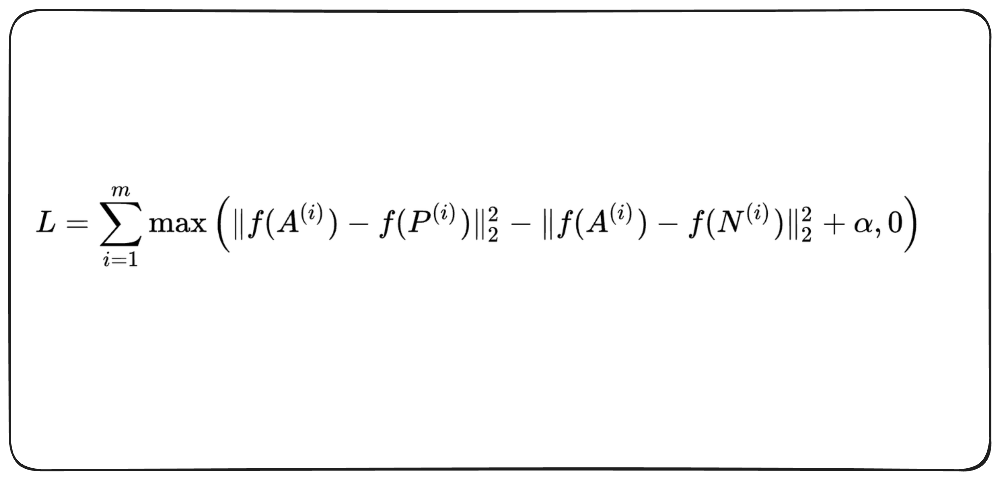
- Pushes positive closer to anchor, negative further away



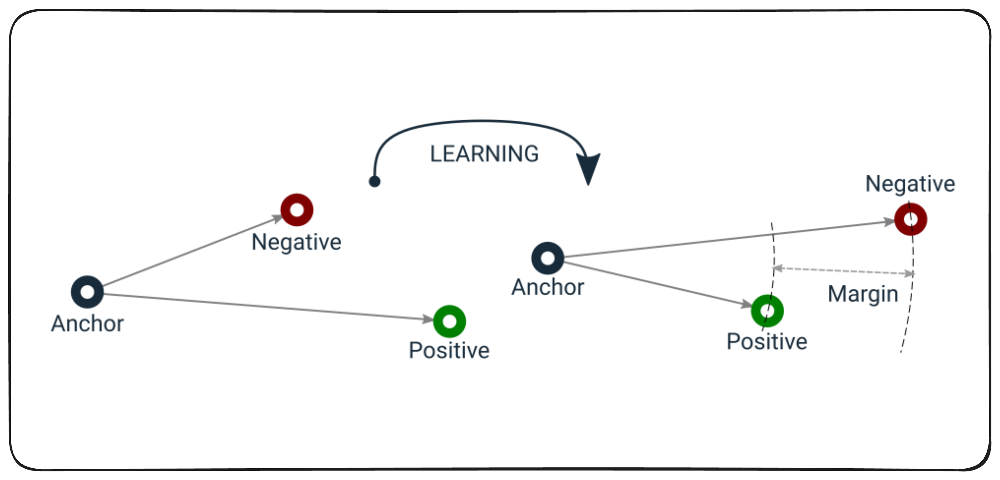

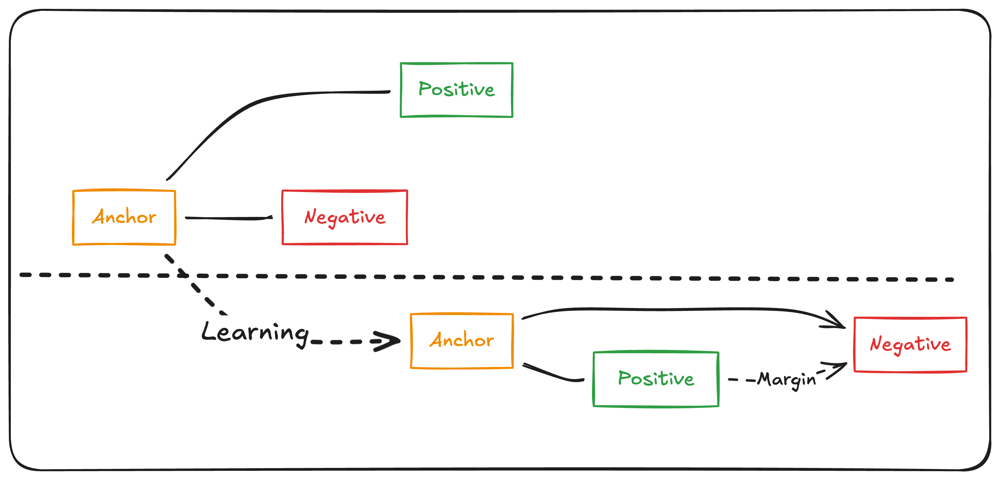

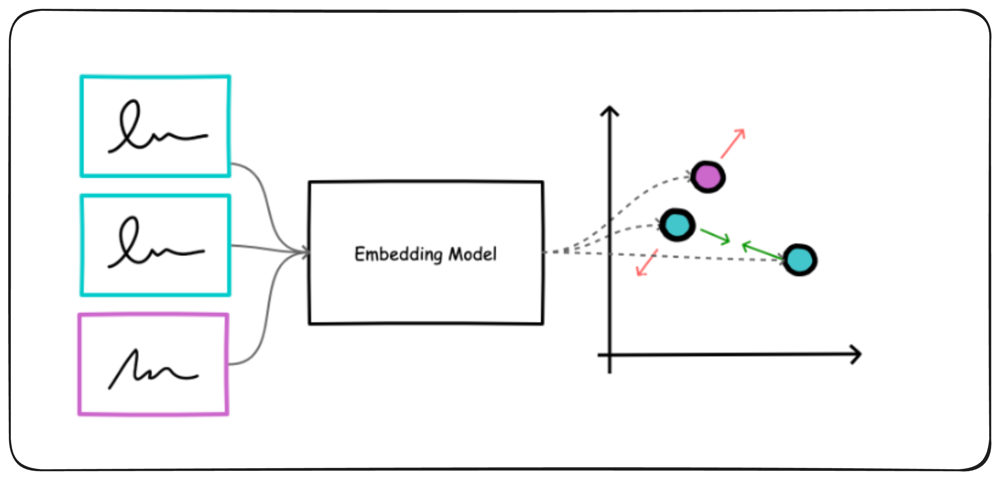

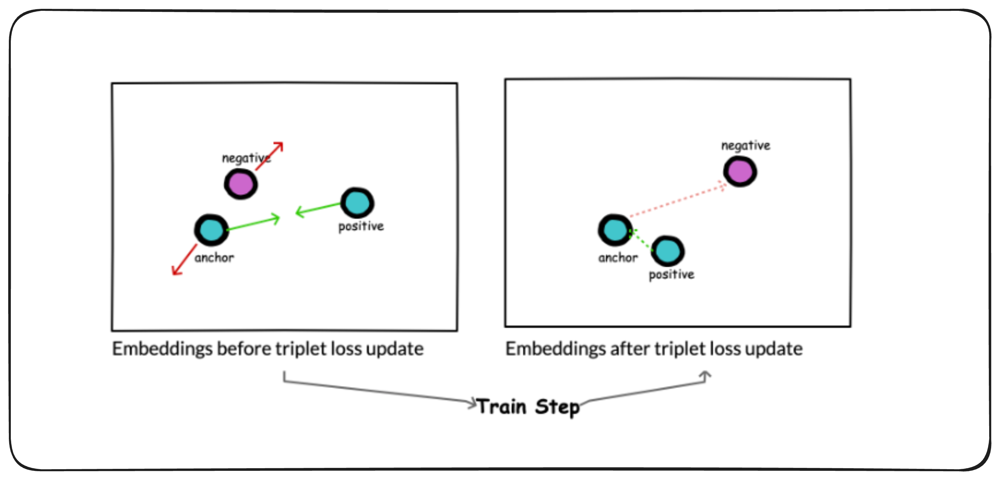

**Other Common Losses** (mentioned for completeness):
- **MultipleNegativesRankingLoss**: Uses in-batch negatives; efficient for large batches
- **CosineSimilarityLoss**: Regresses to target similarity score
- **ContrastiveLoss**: Binary loss for positive/negative pairs

In [ ]:
# Prepare triplet data for Bi-Encoder fine-tuning
def create_triplet_examples(queries, corpus, num_triplets=500):
    """
    Create triplet examples: (anchor_query, positive_doc, negative_doc)
    """
    triplet_examples = []
    np.random.seed(42)

    for i in range(min(num_triplets, len(queries))):
        anchor = queries[i]
        positive = corpus[i]  # Aligned positive

        # Random negative (different from positive)
        neg_idx = np.random.randint(0, len(corpus))
        while neg_idx == i:
            neg_idx = np.random.randint(0, len(corpus))
        negative = corpus[neg_idx]

        triplet_examples.append(
            InputExample(texts=[anchor, positive, negative])
        )

    return triplet_examples

triplet_train_examples = create_triplet_examples(eval_queries, corpus_docs, num_triplets=400)
print(f"✅ Created {len(triplet_train_examples)} triplet training examples")

# Show example
sample = triplet_train_examples[0]
print(f"\nSample Triplet:")
print(f"  Anchor (Query): {sample.texts[0][:60]}...")
print(f"  Positive (Doc): {sample.texts[1][:60]}...")
print(f"  Negative (Doc): {sample.texts[2][:60]}...")

✅ Created 400 triplet training examples

Sample Triplet:
  Anchor (Query): What is the preamble of the Universal Declaration of Human R...
  Positive (Doc): Universal Declaration of Human Rights

Preamble...
  Negative (Doc): However, the Court shall continue the examination of the app...


### 📊 TensorBoard Logging

We'll use TensorBoard to monitor training progress. TensorBoard logs:
- **Training loss** at each step
- **Learning rate** schedule

**To view TensorBoard in Colab:**
```python
%load_ext tensorboard
%tensorboard --logdir ./runs
```

In [ ]:
# TensorBoard setup for training monitoring
from torch.utils.tensorboard import SummaryWriter
import os

# Create log directories
os.makedirs('./runs/bi_encoder', exist_ok=True)
os.makedirs('./runs/cross_encoder', exist_ok=True)

print("✅ TensorBoard directories created")
print("   Bi-Encoder logs: ./runs/bi_encoder")
print("   Cross-Encoder logs: ./runs/cross_encoder")
print("\n💡 To view TensorBoard in Colab, run:")
print("   %load_ext tensorboard")
print("   %tensorboard --logdir ./runs")

✅ TensorBoard directories created
   Bi-Encoder logs: ./runs/bi_encoder
   Cross-Encoder logs: ./runs/cross_encoder

💡 To view TensorBoard in Colab, run:
   %load_ext tensorboard
   %tensorboard --logdir ./runs


In [ ]:
# Initialize model for fine-tuning
bi_encoder_finetune = SentenceTransformer(DEFAULT_BI_ENCODER_MODEL, device=device)

# Create DataLoader
train_dataloader = DataLoader(
    triplet_train_examples,
    shuffle=True,
    batch_size=16
)

# Define Triplet Loss
# Margin: minimum difference between positive and negative distances
triplet_loss = losses.TripletLoss(
    model=bi_encoder_finetune,
    distance_metric=losses.TripletDistanceMetric.COSINE,
    triplet_margin=0.5  # Margin for triplet loss
)

print("✅ Triplet Loss configured")
print(f"   Distance metric: Cosine")
print(f"   Margin: 0.5")

✅ Triplet Loss configured
   Distance metric: Cosine
   Margin: 0.5


In [ ]:
# Fine-tune the Bi-Encoder
print("🚀 Fine-tuning Bi-Encoder with Triplet Loss...")
print("   This may take a few minutes...\n")

# Training parameters (reduced for demo)
num_epochs = 10
warmup_steps = int(len(train_dataloader) * num_epochs * 0.1)

bi_encoder_finetune.fit(
    train_objectives=[(train_dataloader, triplet_loss)],
    epochs=num_epochs,
    warmup_steps=warmup_steps,
    output_path="./bi_encoder_finetuned",
    show_progress_bar=True
)

print("\n✅ Bi-Encoder fine-tuning complete!")
print("   Model saved to: ./bi_encoder_finetuned")

🚀 Fine-tuning Bi-Encoder with Triplet Loss...
   This may take a few minutes...



Computing widget examples:   0%|          | 0/1 [00:00<?, ?example/s]

wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice:

 3


wandb: You chose "Don't visualize my results"


wandb: Detected [litellm, openai] in use.
wandb: Use W&B Weave for improved LLM call tracing. Install Weave with `pip install weave` then add `import weave` to the top of your script.
wandb: For more information, check out the docs at: https://weave-docs.wandb.ai/


Step,Training Loss



✅ Bi-Encoder fine-tuning complete!
   Model saved to: ./bi_encoder_finetuned


In [ ]:
# Build index with fine-tuned model
print("Building FAISS index with fine-tuned Bi-Encoder...")
finetuned_index, finetuned_doc_embeddings = build_faiss_index(bi_encoder_finetune, corpus_docs)

Building FAISS index with fine-tuned Bi-Encoder...
Encoding documents...


Batches:   0%|          | 0/16 [00:00<?, ?it/s]

✅ FAISS index built with 500 documents


---

<a id="7-finetune-cross-encoder"></a>
## 7. Fine-Tuning Cross-Encoder with BCE Loss

### Experiment B (Part 2): Train Domain-Specific Cross-Encoder

#### Binary Cross-Entropy Loss

Cross-Encoders are trained as binary classifiers:
- **Input**: (query, document) pair
- **Output**: Relevance probability (0 to 1)
- **Loss**: BCE loss comparing predicted probability to true label

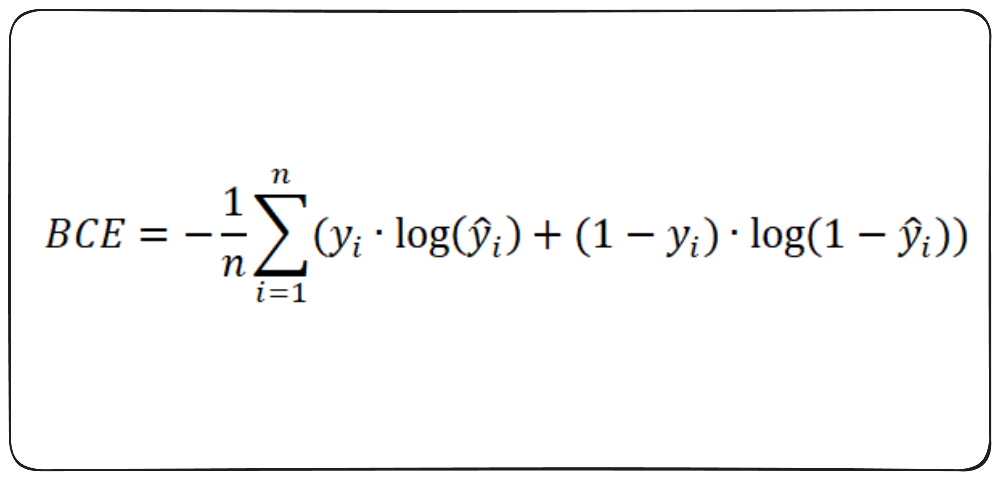

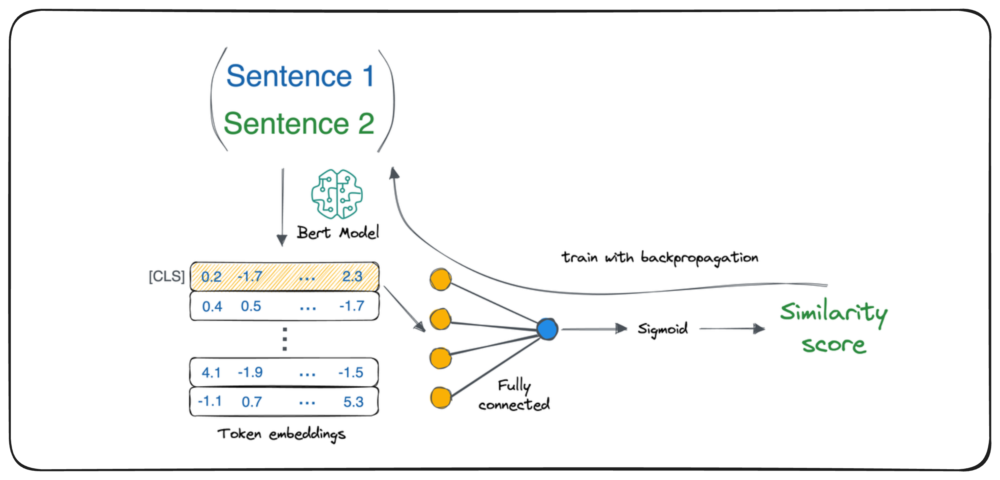

In [ ]:
# Prepare Cross-Encoder training data
print("📊 Cross-Encoder Training Data Format:")
print("-" * 50)
print(f"Total examples: {len(cross_encoder_train)}")
print(f"Positive pairs (label=1): {sum(1 for x in cross_encoder_train if x.label == 1.0)}")
print(f"Negative pairs (label=0): {sum(1 for x in cross_encoder_train if x.label == 0.0)}")

# Show example
pos_example = [x for x in cross_encoder_train if x.label == 1.0][0]
neg_example = [x for x in cross_encoder_train if x.label == 0.0][0]

print(f"\nPositive Example:")
print(f"  Query: {pos_example.texts[0][:50]}...")
print(f"  Doc: {pos_example.texts[1][:50]}...")
print(f"  Label: {pos_example.label}")

print(f"\nNegative Example:")
print(f"  Query: {neg_example.texts[0][:50]}...")
print(f"  Doc: {neg_example.texts[1][:50]}...")
print(f"  Label: {neg_example.label}")

📊 Cross-Encoder Training Data Format:
--------------------------------------------------
Total examples: 1000
Positive pairs (label=1): 500
Negative pairs (label=0): 500

Positive Example:
  Query: What is the preamble of the Universal Declaration ...
  Doc: Universal Declaration of Human Rights

Preamble...
  Label: 1.0

Negative Example:
  Query: What is the preamble of the Universal Declaration ...
  Doc: However, the Court shall continue the examination ...
  Label: 0.0


In [ ]:
# Initialize Cross-Encoder for fine-tuning
cross_encoder_finetune = CrossEncoder(
    DEFAULT_CROSS_ENCODER_MODEL,
    num_labels=1,  # Single score output
    device=device
)

print("✅ Cross-Encoder initialized for fine-tuning")
print(f"   Base model: {DEFAULT_CROSS_ENCODER_MODEL}")

✅ Cross-Encoder initialized for fine-tuning
   Base model: cross-encoder/ms-marco-MiniLM-L-6-v2


In [ ]:
# Prepare training data in the format expected by CrossEncoder
train_samples = [
    InputExample(texts=[ex.texts[0], ex.texts[1]], label=ex.label)
    for ex in cross_encoder_train
]

# Create DataLoader
ce_train_dataloader = DataLoader(
    train_samples,
    shuffle=True,
    batch_size=16
)

print(f"✅ DataLoader created with {len(train_samples)} samples")

✅ DataLoader created with 1000 samples


In [ ]:
# Fine-tune the Cross-Encoder
from sentence_transformers.cross_encoder.losses import BinaryCrossEntropyLoss

print("🚀 Fine-tuning Cross-Encoder with BCE Loss...")
print("   This may take a few minutes...\n")

# Define BCE Loss
bce_loss = BinaryCrossEntropyLoss(model=cross_encoder_finetune)

# Training parameters
num_epochs = 10
warmup_steps = int(len(ce_train_dataloader) * num_epochs * 0.1)

cross_encoder_finetune.fit(
    train_dataloader=ce_train_dataloader,
    #loss_fct=bce_loss,
    epochs=num_epochs,
    warmup_steps=warmup_steps,
    output_path="./cross_encoder_finetuned",
    show_progress_bar=True
)

print("\n✅ Cross-Encoder fine-tuning complete!")
print("   Model saved to: ./cross_encoder_finetuned")

🚀 Fine-tuning Cross-Encoder with BCE Loss...
   This may take a few minutes...



Step,Training Loss
500,0.052200



✅ Cross-Encoder fine-tuning complete!
   Model saved to: ./cross_encoder_finetuned


---

<a id="8-evaluation"></a>
## 8. Evaluation Comparison with Opik

Now let's compare the performance of default vs fine-tuned models and log everything to Opik.

In [ ]:
# Evaluate fine-tuned Bi-Encoder
print("📊 Evaluating Fine-tuned Bi-Encoder...")
finetuned_bi_metrics = evaluate_bi_encoder(
    bi_encoder_finetune,
    finetuned_index,
    eval_queries,
    corpus_docs,
    None
)

print("\n✅ Fine-tuned Bi-Encoder Metrics:")
for metric, value in finetuned_bi_metrics.items():
    print(f"   {metric}: {value:.4f}")

📊 Evaluating Fine-tuned Bi-Encoder...


Evaluating:   0%|          | 0/100 [00:00<?, ?it/s]


✅ Fine-tuned Bi-Encoder Metrics:
   recall@1: 0.2700
   recall@5: 0.9800
   recall@10: 0.9900
   mrr: 0.5573


In [ ]:
# Evaluate fine-tuned Cross-Encoder (Re-ranking)
print("📊 Evaluating Fine-tuned Cross-Encoder (Re-ranking)...")
finetuned_ce_metrics = evaluate_cross_encoder_reranking(
    bi_encoder_finetune,  # Use fine-tuned bi-encoder
    finetuned_index,
    cross_encoder_finetune,
    eval_queries,
    corpus_docs
)

print("\n✅ Fine-tuned Cross-Encoder Re-ranking Metrics:")
for metric, value in finetuned_ce_metrics.items():
    print(f"   {metric}: {value:.4f}")

📊 Evaluating Fine-tuned Cross-Encoder (Re-ranking)...


Evaluating re-ranking:   0%|          | 0/100 [00:00<?, ?it/s]

OPIK: Failed to process CreateSpansBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 18:00:23 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'set-cookie': 'AWSALB=aNVhHgwdO6dWc7i+nve6Y4VKSC5iz+cnqxXwFvmxpr9tuREb1ET/MwfNdd3KXaBvtnAGF0hnKCPp8fODbrdTUieE/nHVuhN0s2Hv8nU35zOvXd7p3UghpAxMty1A; Expires=Sun, 25 Jan 2026 18:00:23 GMT; Path=/, AWSALBCORS=aNVhHgwdO6dWc7i+nve6Y4VKSC5iz+cnqxXwFvmxpr9tuREb1ET/MwfNdd3KXaBvtnAGF0hnKCPp8fODbrdTUieE/nHVuhN0s2Hv8nU35zOvXd7p3UghpAxMty1A; Expires=Sun, 25 Jan 2026 18:00:23 GMT; Path=/; SameSite=None; Secure', 'server': 'nginx', 'vary': 'Accept-Encoding', 'x-opik-nginx': 'frontend', 'x-trace-id': 'a046a2f6294ad6c252d536d575ce38c3'}, status_code: 401, body: {'code': 401, 'message': 'API key should be provided'}
OPIK: Failed to process CreateTraceBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 18:00:23 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'se


✅ Fine-tuned Cross-Encoder Re-ranking Metrics:
   rerank_recall@1: 0.2900
   rerank_recall@5: 0.9800
   rerank_recall@10: 0.9900
   rerank_mrr: 0.5794


In [ ]:
# Create comprehensive comparison table
@track(name="log_comparison_metrics")
def create_comparison_table(default_bi, finetuned_bi, default_ce, finetuned_ce):
    """Create and log comparison metrics."""

    comparison_data = {
        'Metric': [],
        'Default Bi-Encoder': [],
        'Fine-tuned Bi-Encoder': [],
        'Improvement (Bi)': [],
        'Default Cross-Encoder': [],
        'Fine-tuned Cross-Encoder': [],
        'Improvement (CE)': []
    }

    # Bi-Encoder metrics
    for metric in ['recall@1', 'recall@5', 'recall@10', 'mrr']:
        comparison_data['Metric'].append(metric)
        comparison_data['Default Bi-Encoder'].append(f"{default_bi[metric]:.4f}")
        comparison_data['Fine-tuned Bi-Encoder'].append(f"{finetuned_bi[metric]:.4f}")
        improvement = (finetuned_bi[metric] - default_bi[metric]) * 100
        comparison_data['Improvement (Bi)'].append(f"{improvement:+.2f}%")

        # Cross-Encoder metrics (mapped names)
        ce_metric = f"rerank_{metric}"
        comparison_data['Default Cross-Encoder'].append(f"{default_ce[ce_metric]:.4f}")
        comparison_data['Fine-tuned Cross-Encoder'].append(f"{finetuned_ce[ce_metric]:.4f}")
        ce_improvement = (finetuned_ce[ce_metric] - default_ce[ce_metric]) * 100
        comparison_data['Improvement (CE)'].append(f"{ce_improvement:+.2f}%")

    df = pd.DataFrame(comparison_data)

    # Log to Opik
    opik_context.update_current_trace(
        metadata={
            "experiment_type": "comparison",
            "bi_encoder_recall@5_improvement": finetuned_bi['recall@5'] - default_bi['recall@5'],
            "cross_encoder_mrr_improvement": finetuned_ce['rerank_mrr'] - default_ce['rerank_mrr']
        }
    )

    return df

# Generate comparison
comparison_df = create_comparison_table(
    default_bi_metrics, finetuned_bi_metrics,
    default_ce_metrics, finetuned_ce_metrics
)

print("\n" + "=" * 100)
print("📊 EXPERIMENT COMPARISON: Default vs Fine-Tuned Models")
print("=" * 100)
print(comparison_df.to_string(index=False))
print("=" * 100)


📊 EXPERIMENT COMPARISON: Default vs Fine-Tuned Models
   Metric Default Bi-Encoder Fine-tuned Bi-Encoder Improvement (Bi) Default Cross-Encoder Fine-tuned Cross-Encoder Improvement (CE)
 recall@1             0.2600                0.2700           +1.00%                0.2900                   0.2900           +0.00%
 recall@5             0.8700                0.9800          +11.00%                0.9400                   0.9800           +4.00%
recall@10             0.9100                0.9900           +8.00%                0.9400                   0.9900           +5.00%
      mrr             0.5132                0.5573           +4.41%                0.5610                   0.5794           +1.85%


OPIK: Failed to process CreateTraceBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 18:00:59 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'set-cookie': 'AWSALB=YmrR5HfZTA8ckERXlUAQiIRgE8xjpozyCQKcMv4CQ315JPjmorMTqeFAOnKQciWUyK8h1IIBwT2f23OaIQ+1qeFc2Bz2uXB2DdJ5ZGXiQfDuHFoHReDXiJjCpwDE; Expires=Sun, 25 Jan 2026 18:00:59 GMT; Path=/, AWSALBCORS=YmrR5HfZTA8ckERXlUAQiIRgE8xjpozyCQKcMv4CQ315JPjmorMTqeFAOnKQciWUyK8h1IIBwT2f23OaIQ+1qeFc2Bz2uXB2DdJ5ZGXiQfDuHFoHReDXiJjCpwDE; Expires=Sun, 25 Jan 2026 18:00:59 GMT; Path=/; SameSite=None; Secure', 'server': 'nginx', 'vary': 'Accept-Encoding', 'x-opik-nginx': 'frontend', 'x-trace-id': 'a89aab23bd5a72b654e40bc75c85238c'}, status_code: 401, body: {'code': 401, 'message': 'API key should be provided'}
OPIK: Failed to process CreateSpansBatchMessage. Error: headers: {'date': 'Sun, 18 Jan 2026 18:00:59 GMT', 'content-type': 'application/json', 'content-length': '51', 'connection': 'keep-alive', 'se

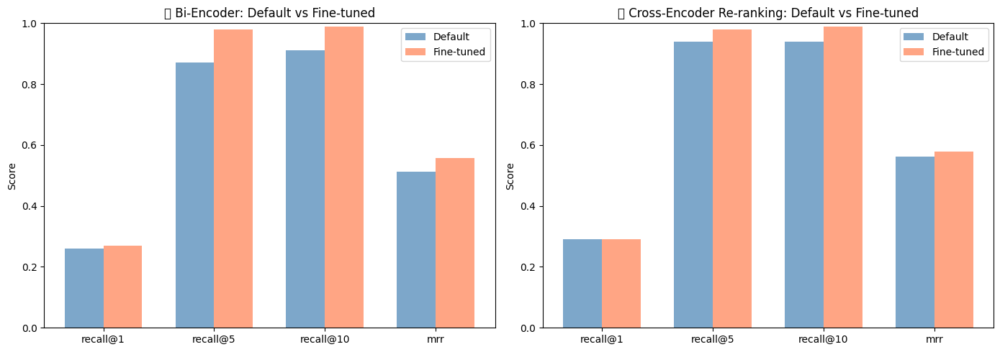


📈 Chart saved as 'model_comparison.png'


In [ ]:
# Visualize the comparison
import matplotlib.pyplot as plt

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# Bi-Encoder comparison
metrics = ['recall@1', 'recall@5', 'recall@10', 'mrr']
x = np.arange(len(metrics))
width = 0.35

ax1 = axes[0]
default_values = [default_bi_metrics[m] for m in metrics]
finetuned_values = [finetuned_bi_metrics[m] for m in metrics]

bars1 = ax1.bar(x - width/2, default_values, width, label='Default', color='steelblue', alpha=0.7)
bars2 = ax1.bar(x + width/2, finetuned_values, width, label='Fine-tuned', color='coral', alpha=0.7)

ax1.set_ylabel('Score')
ax1.set_title('🔷 Bi-Encoder: Default vs Fine-tuned')
ax1.set_xticks(x)
ax1.set_xticklabels(metrics)
ax1.legend()
ax1.set_ylim(0, 1)

# Cross-Encoder comparison
ax2 = axes[1]
ce_metrics = ['rerank_recall@1', 'rerank_recall@5', 'rerank_recall@10', 'rerank_mrr']
ce_labels = ['recall@1', 'recall@5', 'recall@10', 'mrr']

default_ce_values = [default_ce_metrics[m] for m in ce_metrics]
finetuned_ce_values = [finetuned_ce_metrics[m] for m in ce_metrics]

bars3 = ax2.bar(x - width/2, default_ce_values, width, label='Default', color='steelblue', alpha=0.7)
bars4 = ax2.bar(x + width/2, finetuned_ce_values, width, label='Fine-tuned', color='coral', alpha=0.7)

ax2.set_ylabel('Score')
ax2.set_title('🔶 Cross-Encoder Re-ranking: Default vs Fine-tuned')
ax2.set_xticks(x)
ax2.set_xticklabels(ce_labels)
ax2.legend()
ax2.set_ylim(0, 1)

plt.tight_layout()
plt.savefig('model_comparison.png', dpi=150, bbox_inches='tight')
plt.show()
print("\n📈 Chart saved as 'model_comparison.png'")

## Hard Negatives Mining: A Primer for Reranker Training

### What Are Negatives in Reranker Training?

When training a reranker (cross-encoder) model, the goal is to teach it to distinguish between documents that are **relevant** to a query and documents that are **not relevant**. The training data typically consists of:

- **Positives**: Documents that correctly answer or match the query
- **Negatives**: Documents that do *not* answer the query and should be scored lower

The quality of your negatives directly impacts how well your reranker learns to discriminate relevance.

### Soft (Easy) Negatives vs. Hard Negatives

Not all negatives are equally useful for training. They fall into two categories:

**Soft Negatives (Easy Negatives)**  
Documents that are obviously unrelated to the query. They share no topical overlap and are trivial for the model to reject.

**Hard Negatives**  
Documents that *appear* related to the query — they may share keywords, topics, or surface-level similarity — but are actually not the correct answer. These are the challenging cases that push the model to learn fine-grained distinctions.

**Example:**

| Query | Type | Document |
|-------|------|----------|
| "Where was Apple founded?" | **Soft Negative** | "The Cache River Bridge is a Parker pony truss that spans the Cache River between Walnut Ridge and Paragould, Arkansas." |
| "Where was Apple founded?" | **Hard Negative** | "The Fuji apple is an apple cultivar developed in the late 1930s, and brought to market in 1962." |

The soft negative is completely unrelated — any model would score it low. The hard negative is tricky: it mentions "apple" and contains dates and locations, making it superficially plausible. A model trained only on soft negatives might incorrectly score this document highly.

### Why Hard Negatives Matter

Rerankers are designed to solve a challenging problem: given a set of *already-retrieved* documents that are all somewhat related to the query, determine which ones are most relevant. If a reranker only sees easy negatives during training, it never learns to make the fine distinctions required in real retrieval scenarios.

Training with hard negatives teaches the model to:

- **Distinguish near-misses from true matches** — Documents that relate to the topic but don't actually answer the question
- **Resist keyword matching traps** — Documents that share vocabulary but have different meaning
- **Learn stricter relevance criteria** — Moving beyond surface similarity to semantic correctness

The result is a reranker that performs significantly better when reordering the top-k results from a first-stage retriever, where all candidates are at least somewhat related to the query.

### Mining Strategies for Hard Negatives

Generating hard negatives requires finding documents that are similar enough to be challenging but confirmed to be non-relevant. Common approaches include:

**Embedding Model Mining**  
Use a fast embedding model (bi-encoder) to find documents that are semantically similar to the query but are not the labeled positive. These are documents that would fool a simpler retrieval system.

**BM25 / Keyword Retrieval**  
Retrieve documents with high lexical overlap (shared keywords) that aren't the correct answer. These create hard negatives based on vocabulary matching.

**In-Batch Negatives**  
Treat other positive documents in the same training batch as negatives for each query. This is computationally efficient but may produce easier negatives.

**Top-K Retrieval Negatives**  
Run your first-stage retriever and take results that rank highly but aren't the true positive. These directly simulate the reranking task.

### Practical Considerations

**Don't use only hard negatives.** If you train exclusively on hard negatives, your model may become overly strict and perform worse on easier cases — sometimes reranking the top-100 results gives worse performance than reranking the top-50 because the model struggles with obviously irrelevant documents. Mix in some random (soft) negatives to maintain calibration.

**Quality over quantity.** A smaller set of well-chosen hard negatives often outperforms a larger set of random negatives. The margin between positive and negative similarity scores matters — negatives that are very close to the positive in embedding space provide the strongest learning signal.

**Match your evaluation scenario.** If your reranker will process the top-30 results from a specific retriever, mine negatives using that same retriever to create realistic training conditions.

Hard negative mining is one of the highest-leverage techniques for improving reranker quality. Models trained with carefully selected hard negatives consistently outperform those trained with random or easy negatives, often by substantial margins.

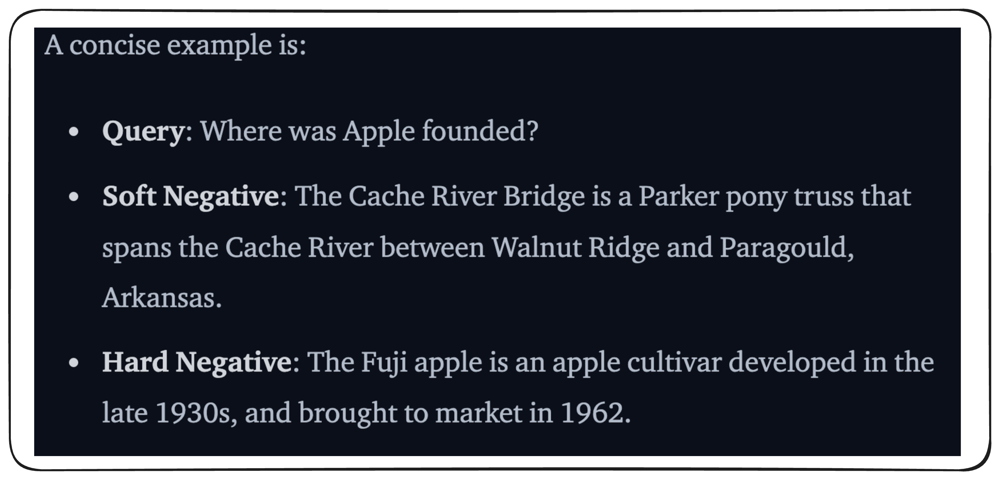

Util for hard negative mining https://sbert.net/docs/package_reference/util.html#sentence_transformers.util.mine_hard_negatives

### [Ref](https://huggingface.co/blog/train-reranker)

---

<a id="9-rag-pipeline"></a>
## 9. RAG Pipeline with Fine-Tuned Models

Now let's build a complete RAG pipeline that combines:
1. **Fine-tuned Bi-Encoder** for fast initial retrieval
2. **Fine-tuned Cross-Encoder** for precise re-ranking
3. **LangChain** for pipeline orchestration

In [ ]:
# RAG Pipeline Components
from langchain_core.documents import Document
from langchain_community.vectorstores import FAISS as LangChainFAISS
from langchain_huggingface import HuggingFaceEmbeddings

print("🔧 Setting up RAG Pipeline Components...")

🔧 Setting up RAG Pipeline Components...


In [ ]:
class TwoStageRAGPipeline:
    """
    A complete RAG pipeline with:
    - Stage 1: Bi-Encoder retrieval (fast, approximate)
    - Stage 2: Cross-Encoder re-ranking (precise)
    """

    def __init__(self, bi_encoder, cross_encoder, documents):
        self.bi_encoder = bi_encoder
        self.cross_encoder = cross_encoder
        self.documents = documents

        # Build FAISS index
        print("Building document index...")
        self.doc_embeddings = bi_encoder.encode(
            documents,
            show_progress_bar=True,
            convert_to_numpy=True
        )
        faiss.normalize_L2(self.doc_embeddings)

        self.index = faiss.IndexFlatIP(self.doc_embeddings.shape[1])
        self.index.add(self.doc_embeddings)
        print(f"✅ Index built with {len(documents)} documents")

    @track(name="rag_retrieve")
    def retrieve(self, query, top_k_retrieve=20, top_k_rerank=5):
        """
        Two-stage retrieval:
        1. Bi-Encoder: Retrieve top_k_retrieve candidates
        2. Cross-Encoder: Re-rank to top_k_rerank
        """
        # Stage 1: Bi-Encoder retrieval
        query_embedding = self.bi_encoder.encode([query], convert_to_numpy=True)
        faiss.normalize_L2(query_embedding)

        scores, indices = self.index.search(query_embedding, top_k_retrieve)

        candidates = [
            {'document': self.documents[idx], 'bi_score': float(score), 'index': idx}
            for score, idx in zip(scores[0], indices[0])
        ]

        # Stage 2: Cross-Encoder re-ranking
        pairs = [[query, c['document']] for c in candidates]
        ce_scores = self.cross_encoder.predict(pairs)

        for i, score in enumerate(ce_scores):
            candidates[i]['ce_score'] = float(score)

        # Sort by Cross-Encoder score
        candidates.sort(key=lambda x: x['ce_score'], reverse=True)

        # Log to Opik
        opik_context.update_current_trace(
            input={"query": query},
            output={"num_results": len(candidates[:top_k_rerank])},
            metadata={
                "top_k_retrieve": top_k_retrieve,
                "top_k_rerank": top_k_rerank
            }
        )

        return candidates[:top_k_rerank]

    def get_context(self, query, top_k=3):
        """Get concatenated context for LLM generation."""
        results = self.retrieve(query, top_k_rerank=top_k)
        context = "\n\n".join([r['document'] for r in results])
        return context, results

# Initialize pipeline with fine-tuned models
print("\n🚀 Initializing Two-Stage RAG Pipeline...")
rag_pipeline = TwoStageRAGPipeline(
    bi_encoder=bi_encoder_finetune,
    cross_encoder=cross_encoder_finetune,
    documents=corpus_docs
)


🚀 Initializing Two-Stage RAG Pipeline...
Building document index...


Batches:   0%|          | 0/16 [00:00<?, ?it/s]

✅ Index built with 500 documents


In [ ]:
# Test the RAG pipeline
print("\n" + "=" * 80)
print("🔍 RAG Pipeline Demo")
print("=" * 80)

test_queries = [
    "What are the basic human rights that every person should have?",
    "How are human rights protected internationally?",
    "What happens when human rights are violated?"
]

for query in test_queries:
    print(f"\n📝 Query: {query}")
    print("-" * 60)

    results = rag_pipeline.retrieve(query, top_k_retrieve=10, top_k_rerank=3)

    print("\n🎯 Top 3 Results (after re-ranking):")
    for i, res in enumerate(results, 1):
        print(f"\n  {i}. CE Score: {res['ce_score']:.4f} | Bi Score: {res['bi_score']:.4f}")
        print(f"     Doc: {res['document'][:100]}...")


🔍 RAG Pipeline Demo

📝 Query: What are the basic human rights that every person should have?
------------------------------------------------------------

🎯 Top 3 Results (after re-ranking):

  1. CE Score: 6.6574 | Bi Score: 0.5560
     Doc: people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort,...

  2. CE Score: 6.6574 | Bi Score: 0.5560
     Doc: people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort,...

  3. CE Score: 2.4793 | Bi Score: 0.5123
     Doc: Whereas recognition of the inherent dignity and of the equal and inalienable

rights of all members ...

📝 Query: How are human rights protected internationally?
------------------------------------------------------------

🎯 Top 3 Results (after re-ranking):

  1. CE Score: 5.7450 | Bi Score: 0.5620
     Doc: people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort,...

  2. CE Score: 5.7450 | Bi 

In [ ]:
# Complete RAG with context retrieval
print("\n" + "=" * 80)
print("📚 Complete RAG Context Retrieval")
print("=" * 80)

query = "What mechanisms exist to protect human rights globally?"
context, results = rag_pipeline.get_context(query, top_k=3)

print(f"\n📝 Query: {query}")
print(f"\n📄 Retrieved Context (would be sent to LLM):")
print("-" * 60)
print(context[:800] + "..." if len(context) > 800 else context)

print("\n" + "-" * 60)
print("💡 This context would then be passed to an LLM (e.g., GPT-4, Claude)")
print("   with the user's query to generate the final response.")


📚 Complete RAG Context Retrieval

📝 Query: What mechanisms exist to protect human rights globally?

📄 Retrieved Context (would be sent to LLM):
------------------------------------------------------------
Convention for the Protection of Human Rights and Fundamental Freedoms ............................................ 5

Protocol ...................................................................... 33

Protocol No. 4............................................................. 36

Protocol No. 6............................................................. 40

Protocol No. 7............................................................. 44

people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort, to rebellion against tyranny and oppression, that human rights should be

protected by the rule of law,

Whereas it is essential to promote the development of friendly relations between

nations,

Whereas the peoples of the United Nations have in the

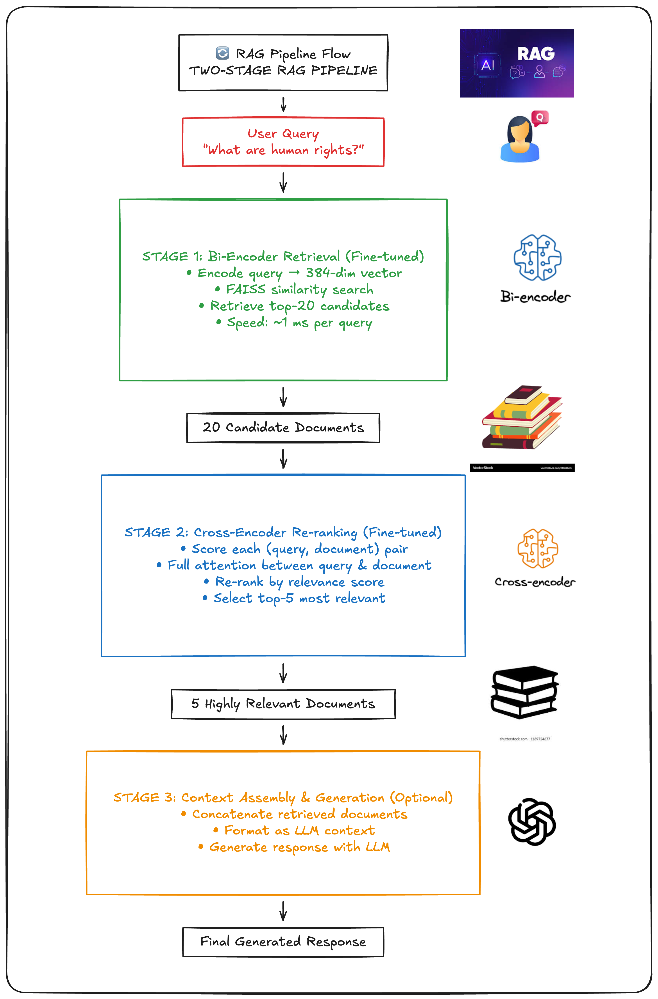

---

<a id="10-summary"></a>
## 10. Summary & Key Takeaways

### 🎯 What We Learned

#### Architecture Comparison

| Aspect | Bi-Encoder | Cross-Encoder |
|--------|------------|---------------|
| **Encoding** | Independent | Joint |
| **Speed** | Fast (pre-compute docs) | Slow (pair-wise) |
| **Accuracy** | Good | Excellent |
| **Scalability** | Millions of docs | Hundreds of docs |
| **Use Case** | First-stage retrieval | Re-ranking |

#### Training Approaches

| Model | Loss Function | Training Data Format |
|-------|--------------|----------------------|
| **Bi-Encoder** | Triplet Loss | (anchor, positive, negative) |
| **Cross-Encoder** | BCE Loss | (query, document, label) |

### 📈 Experiment Results Summary

In [ ]:
# Final summary
print("\n" + "=" * 80)
print("📊 FINAL EXPERIMENT SUMMARY")
print("=" * 80)

print("\n🔷 Bi-Encoder Results:")
print("-" * 40)
for metric in ['recall@1', 'recall@5', 'recall@10', 'mrr']:
    default = default_bi_metrics[metric]
    finetuned = finetuned_bi_metrics[metric]
    change = ((finetuned - default) / default) * 100 if default > 0 else 0
    print(f"  {metric:12s}: {default:.4f} → {finetuned:.4f} ({change:+.1f}%)")

print("\n🔶 Cross-Encoder Re-ranking Results:")
print("-" * 40)
for metric in ['rerank_recall@1', 'rerank_recall@5', 'rerank_recall@10', 'rerank_mrr']:
    default = default_ce_metrics[metric]
    finetuned = finetuned_ce_metrics[metric]
    change = ((finetuned - default) / default) * 100 if default > 0 else 0
    display_name = metric.replace('rerank_', '')
    print(f"  {display_name:12s}: {default:.4f} → {finetuned:.4f} ({change:+.1f}%)")

print("\n" + "=" * 80)


📊 FINAL EXPERIMENT SUMMARY

🔷 Bi-Encoder Results:
----------------------------------------
  recall@1    : 0.2600 → 0.2700 (+3.8%)
  recall@5    : 0.8700 → 0.9800 (+12.6%)
  recall@10   : 0.9100 → 0.9900 (+8.8%)
  mrr         : 0.5132 → 0.5573 (+8.6%)

🔶 Cross-Encoder Re-ranking Results:
----------------------------------------
  recall@1    : 0.2900 → 0.2900 (+0.0%)
  recall@5    : 0.9400 → 0.9800 (+4.3%)
  recall@10   : 0.9400 → 0.9900 (+5.3%)
  mrr         : 0.5610 → 0.5794 (+3.3%)



### 🚀 Key Takeaways

1. **Two-Stage Retrieval** is the industry standard for production RAG systems
   - Bi-Encoder for speed and scale
   - Cross-Encoder for precision

2. **Fine-tuning Matters**: Domain-specific training improves both retrieval and re-ranking

3. **Loss Functions**:
   - **Triplet Loss** teaches relative ordering (positive closer than negative)
   - **BCE Loss** teaches absolute relevance scoring

4. **Evaluation with Opik** provides visibility into model performance across experiments

5. **Data Quality** is crucial — good training pairs (positive/negative) drive model performance

---

### 📚 Further Reading

- [SentenceTransformers Documentation](https://www.sbert.net/)
- [Bi-Encoders vs Cross-Encoders](https://www.sbert.net/examples/applications/cross-encoder/README.html)
- [Triplet Loss Paper](https://arxiv.org/abs/1503.03832)
- [Opik Documentation](https://www.comet.com/docs/opik/)
- [FAISS Library](https://github.com/facebookresearch/faiss)

---

### 🎓 Exercise Ideas

1. Try different base models (e.g., `all-mpnet-base-v2` for better quality)
2. Experiment with hard negative mining for better training data
3. Compare `MultipleNegativesRankingLoss` vs `TripletLoss`
4. Add an LLM generation step to complete the RAG pipeline
5. Implement NDCG@K evaluation for multi-relevance datasets

In [ ]:
print("\n" + "=" * 80)
print("✅ Tutorial Complete!")
print("=" * 80)
print("\nAll metrics have been logged to Opik.")
print("View your experiment results in the Opik dashboard.")
print("\n🙏 Thank you for following along!")


✅ Tutorial Complete!

All metrics have been logged to Opik.
View your experiment results in the Opik dashboard.

🙏 Thank you for following along!


---

<a id="11-rag-gpt4o"></a>
## 11. Final RAG Pipeline with Finetuned Retrievers + GPT-4o-mini

Now let's build a complete end-to-end RAG pipeline that:
1. Takes a user query
2. Uses our **fine-tuned Bi-Encoder** to retrieve top-K candidate documents
3. Uses our **fine-tuned Cross-Encoder** to re-rank candidates
4. Passes the top-N documents as context to **GPT-4o-mini** for answer generation

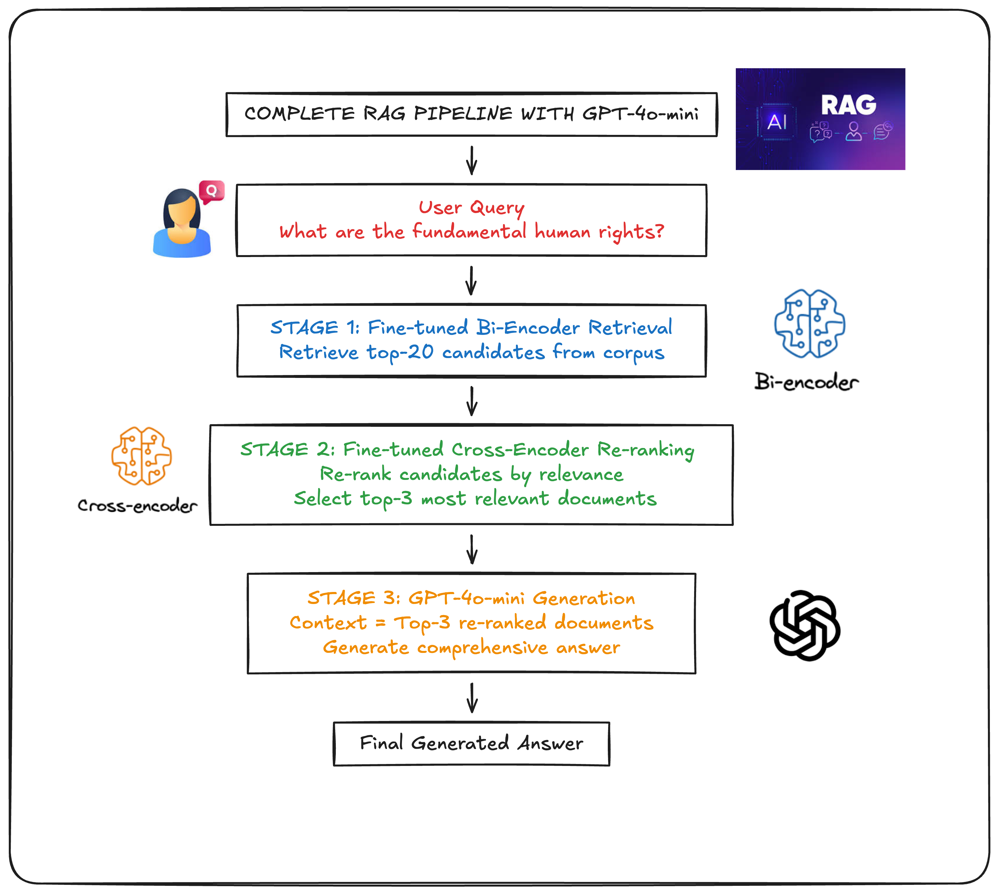

In [ ]:
# Setup OpenAI API for GPT-4o-mini generation
import getpass
from openai import OpenAI

# Securely get API key
print("🔑 Enter your OpenAI API key (press Enter to skip this section):")
openai_api_key = getpass.getpass("OpenAI API Key: ")

if openai_api_key:
    client = OpenAI(api_key=openai_api_key)
    print("\n✅ OpenAI client initialized successfully!")
else:
    client = None
    print("\n⚠️ No API key provided. Skipping GPT-4o-mini generation.")

🔑 Enter your OpenAI API key (press Enter to skip this section):
OpenAI API Key: ··········

✅ OpenAI client initialized successfully!


In [ ]:
# Complete RAG Pipeline with GPT-4o-mini

def rag_with_gpt4o_mini(query, bi_encoder, cross_encoder, faiss_index, corpus,
                        openai_client, top_k_retrieve=20, top_k_rerank=3):
    """
    Complete RAG pipeline using fine-tuned retrievers and GPT-4o-mini.

    Args:
        query: User question
        bi_encoder: Fine-tuned bi-encoder model
        cross_encoder: Fine-tuned cross-encoder model
        faiss_index: FAISS index for retrieval
        corpus: Document corpus
        openai_client: OpenAI client instance
        top_k_retrieve: Number of candidates to retrieve
        top_k_rerank: Number of documents after re-ranking

    Returns:
        dict with retrieved_docs, reranked_docs, and generated_answer
    """
    # Stage 1: Bi-Encoder Retrieval
    query_embedding = bi_encoder.encode([query], convert_to_numpy=True)
    faiss.normalize_L2(query_embedding)
    scores, indices = faiss_index.search(query_embedding, top_k_retrieve)

    retrieved_docs = []
    for score, idx in zip(scores[0], indices[0]):
        retrieved_docs.append({
            'document': corpus[idx],
            'bi_score': float(score),
            'index': int(idx)
        })

    # Stage 2: Cross-Encoder Re-ranking
    pairs = [[query, doc['document']] for doc in retrieved_docs]
    ce_scores = cross_encoder.predict(pairs)

    for i, score in enumerate(ce_scores):
        retrieved_docs[i]['ce_score'] = float(score)

    # Sort by cross-encoder score and take top-k
    reranked_docs = sorted(retrieved_docs, key=lambda x: x['ce_score'], reverse=True)[:top_k_rerank]

    # Stage 3: GPT-4o-mini Generation
    context = "\n\n---\n\n".join([doc['document'] for doc in reranked_docs])

    system_prompt = """You are a helpful assistant that answers questions based on the provided context.
Use only the information from the context to answer. If the context doesn't contain enough information, say so.
Be concise and accurate."""

    user_prompt = f"""Context:
{context}

Question: {query}

Answer:"""

    if openai_client:
        response = openai_client.chat.completions.create(
            model="gpt-4o-mini",
            messages=[
                {"role": "system", "content": system_prompt},
                {"role": "user", "content": user_prompt}
            ],
            temperature=0.3,
            max_tokens=500
        )
        generated_answer = response.choices[0].message.content
    else:
        generated_answer = "[OpenAI client not configured - skipping generation]"

    return {
        'query': query,
        'retrieved_docs': retrieved_docs[:5],  # Show top 5 from retrieval
        'reranked_docs': reranked_docs,
        'generated_answer': generated_answer
    }

print("✅ RAG pipeline function defined")

✅ RAG pipeline function defined


In [ ]:
# Demo: Complete RAG Pipeline with GPT-4o-mini

print("\n" + "="*80)
print("🚀 COMPLETE RAG PIPELINE DEMO: Fine-tuned Retrievers + GPT-4o-mini")
print("="*80)

# Example query
demo_query = "What are the fundamental human rights that every person is entitled to?"

print(f"\n📝 Query: {demo_query}")
print("-" * 60)

# Run the RAG pipeline
result = rag_with_gpt4o_mini(
    query=demo_query,
    bi_encoder=bi_encoder_finetune,
    cross_encoder=cross_encoder_finetune,
    faiss_index=finetuned_index,
    corpus=corpus_docs,
    openai_client=client,
    top_k_retrieve=20,
    top_k_rerank=3
)

# Display Stage 1: Bi-Encoder Retrieval Results
print("\n📊 STAGE 1: Bi-Encoder Retrieval (Top 5 candidates)")
print("-" * 60)
for i, doc in enumerate(result['retrieved_docs'][:5], 1):
    print(f"  {i}. Bi-Score: {doc['bi_score']:.4f}")
    print(f"     {doc['document'][:100]}...\n")

# Display Stage 2: Cross-Encoder Re-ranking Results
print("\n🎯 STAGE 2: Cross-Encoder Re-ranking (Top 3 after re-ranking)")
print("-" * 60)
for i, doc in enumerate(result['reranked_docs'], 1):
    print(f"  {i}. CE-Score: {doc['ce_score']:.4f} | Bi-Score: {doc['bi_score']:.4f}")
    print(f"     {doc['document'][:100]}...\n")

# Display Stage 3: GPT-4o-mini Generated Answer
print("\n💬 STAGE 3: GPT-4o-mini Generated Answer")
print("-" * 60)
print(result['generated_answer'])

print("\n" + "="*80)


🚀 COMPLETE RAG PIPELINE DEMO: Fine-tuned Retrievers + GPT-4o-mini

📝 Query: What are the fundamental human rights that every person is entitled to?
------------------------------------------------------------

📊 STAGE 1: Bi-Encoder Retrieval (Top 5 candidates)
------------------------------------------------------------
  1. Bi-Score: 0.5540
     Article 2

Everyone is entitled to all the rights and freedoms set forth in this Declaration,

witho...

  2. Bi-Score: 0.5540
     Article 2

Everyone is entitled to all the rights and freedoms set forth in this Declaration,

witho...

  3. Bi-Score: 0.5540
     Article 2

Everyone is entitled to all the rights and freedoms set forth in this Declaration,

witho...

  4. Bi-Score: 0.5356
     people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort,...

  5. Bi-Score: 0.5356
     people,

Whereas it is essential, if man is not to be compelled to have recourse, as a last

resort,...


🎯 STAGE 2: Cross

1. [Optional Ref 1](https://weaviate.io/blog/fine-tune-embedding-model)
2. [Optional Ref 2](https://weaviate.io/blog/cross-encoders-as-reranker)
3. [Optional Ref 3](https://www.pinecone.io/learn/series/nlp/sentence-embeddings/)
4. [When to finetune](https://weaviate.io/blog/fine-tune-embedding-model)